<div style="text-align: center;">
<h1>Deep Learning Course - Assignment 1</h1>
<h2>Dog Breed Identification</h2>
<h3>Submitted by: Itay Bouganim, Ido Rom and Shauli Genish</h3>
</div>

<h3>Problem Statement</h3>
<p>
We are provided with a training set and a test set of images of dogs. Each image has a filename that is its unique id. The dataset comprises 120 breeds of dogs. The goal is to create a classifier capable of determining a dog's breed from a photo. The list of breeds is as follows
</p>

<h3>Task Description</h3>
<p>
In this Task, we were provided a strictly canine subset of ImageNet in order to practice fine-grained image categorization. How well we can tell our Norfolk Terriers from our Norwich Terriers? With 120 breeds of dogs and a limited number training images per class, we might find the problem more, err, ruff than we anticipated.</p>

<a href="https://www.kaggle.com/c/dog-breed-identification">Kaggle competition link - containing the dataset and labels</a>

In [14]:
import os
from os.path import join
from os import listdir
import random

import cv2
import numpy as np
import pandas as pd
import tensorflow as tf

import matplotlib.pyplot as plt
from jupyterthemes import jtplot
plt.style.use('fivethirtyeight')
plt.rc_context({'text.color': 'white', 'legend.facecolor': 'black', 'axes.edgecolor':'white', 'axes.labelcolor': 'white', 'xtick.color':'white', 'ytick.color':'white', 'figure.facecolor':'white'})
%matplotlib inline

def display_image(path, label=None):
    import base64, io
    from IPython.core.display import display, HTML
    from PIL import Image as PILImage

    image = PILImage.open(path)

    output = io.BytesIO()
    image.save(output, format='PNG')
    encoded_string = base64.b64encode(output.getvalue()).decode()

    html = '<img src="data:image/png;base64,{}"/>'.format(encoded_string) if label is None else '<div style="text-align: center;">{}<img src="data:image/png;base64,{}" width="200" height="200"/></div>'.format(label, encoded_string)
    display(HTML(html))

<h4>Check for existing physical GPU</h4>

In [3]:
tf.config.list_physical_devices(device_type=None)

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU')]

<h2>1. Preprocessing The Data</h2>

<h4>1.a. Check our dataset size for the train and test data</h4>

In [3]:
data_dir = os.getcwd() + "/data/dog-breed/"

train_dir = join(data_dir, 'train')
test_dir = join(data_dir, 'test')

print(f'Train samples directory path: {train_dir}')
print(f'Test samples directory path: {test_dir}')

train_count = len(listdir(train_dir))
test_count = len(listdir(test_dir))
print(f'\n\nTrain dataset size: {train_count}')
print(f'Test dataset size (unlabeled): {test_count}')

Train samples directory path: C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/train
Test samples directory path: C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/test


Train dataset size: 10222
Test dataset size (unlabeled): 10357


<h4>1.b. Read labels and assign filenames</h4>
The dataset does not contain labels for the test data.</br>
We will read the attached csv file containing labels only for the train samples.

In [5]:

labeled_data = pd.read_csv(join(data_dir, 'labels.csv'))
labeled_data['id'] = labeled_data['id'].apply(lambda name: f"{name}.jpg")

# Create dictonaries from label to index and the opposite
label_to_index = {label:index for index, label in enumerate(labeled_data['breed'].unique())}
index_to_label = {index:label for index, label in enumerate(labeled_data['breed'].unique())}

print("Display top 10 samples from the labeled train data")
labeled_data.head(10)


Display top 10 samples from the labeled train data


,id,breed
0,000bec180eb18c7604dcecc8fe0dba07.jpg,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97.jpg,dingo
2,001cdf01b096e06d78e9e5112d419397.jpg,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d.jpg,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62.jpg,golden_retriever
5,002211c81b498ef88e1b40b9abf84e1d.jpg,bedlington_terrier
6,00290d3e1fdd27226ba27a8ce248ce85.jpg,bedlington_terrier
7,002a283a315af96eaea0e28e7163b21b.jpg,borzoi
8,003df8b8a8b05244b1d920bb6cf451f9.jpg,basenji
9,0042188c895a2f14ef64a918ed9c7b64.jpg,scottish_deerhound


In [6]:
Y_train = labeled_data['breed']
labels = Y_train.unique()
print(f'Labels: \n {labels}')
label_count = len(labels)
print(f'\n\nTotal labeled data: {len(Y_train)}')
print(f"Total classes: {label_count}")
images_shape = (128, 128)

Labels: 
 ['boston_bull' 'dingo' 'pekinese' 'bluetick' 'golden_retriever'
 'bedlington_terrier' 'borzoi' 'basenji' 'scottish_deerhound'
 'shetland_sheepdog' 'walker_hound' 'maltese_dog' 'norfolk_terrier'
 'african_hunting_dog' 'wire-haired_fox_terrier' 'redbone'
 'lakeland_terrier' 'boxer' 'doberman' 'otterhound' 'standard_schnauzer'
 'irish_water_spaniel' 'black-and-tan_coonhound' 'cairn' 'affenpinscher'
 'labrador_retriever' 'ibizan_hound' 'english_setter' 'weimaraner'
 'giant_schnauzer' 'groenendael' 'dhole' 'toy_poodle' 'border_terrier'
 'tibetan_terrier' 'norwegian_elkhound' 'shih-tzu' 'irish_terrier'
 'kuvasz' 'german_shepherd' 'greater_swiss_mountain_dog' 'basset'
 'australian_terrier' 'schipperke' 'rhodesian_ridgeback' 'irish_setter'
 'appenzeller' 'bloodhound' 'samoyed' 'miniature_schnauzer'
 'brittany_spaniel' 'kelpie' 'papillon' 'border_collie' 'entlebucher'
 'collie' 'malamute' 'welsh_springer_spaniel' 'chihuahua' 'saluki' 'pug'
 'malinois' 'komondor' 'airedale' 'leonberg' 

<h3>We can see that we indeed have 120 labeles in the dataset,<br/> The training data is not labeled so in order to determine our progress we will submit our results to Kaggle and use some of the validation data that our model did not train on to help us visualize our progress</h3>

<h4>1.c. Look at the sample count for each label</h4>
Explore the sample count from each label

In [5]:
label_sample_count = labeled_data.groupby(['breed']).agg(['count'])

label_sample_count.head(10)

,id
,count
breed,
affenpinscher,80
afghan_hound,116
african_hunting_dog,86
airedale,107
american_staffordshire_terrier,74
appenzeller,78
australian_terrier,102
basenji,110


In [9]:
print("Mean rounded train samples in each class:")
print(label_sample_count.mean(axis = 0).round())

Mean rounded train samples in each class:
id  count    85.0
dtype: float64


<h4>Most common labels</h4>

In [7]:
labeled_data.groupby("breed").count().sort_values("id", ascending=False).head(10)

,id
breed,
scottish_deerhound,126
maltese_dog,117
afghan_hound,116
entlebucher,115
bernese_mountain_dog,114
shih-tzu,112
great_pyrenees,111
pomeranian,111
basenji,110


<h4>Least common labels</h4>

In [8]:
labeled_data.groupby("breed").count().sort_values("id", ascending=False).tail(10)

,id
breed,
tibetan_mastiff,69
german_shepherd,69
giant_schnauzer,69
walker_hound,69
otterhound,69
golden_retriever,67
brabancon_griffon,67
komondor,67
briard,66


<h4>Plot labels distibution histogram</h4>

Labeled images class distribution


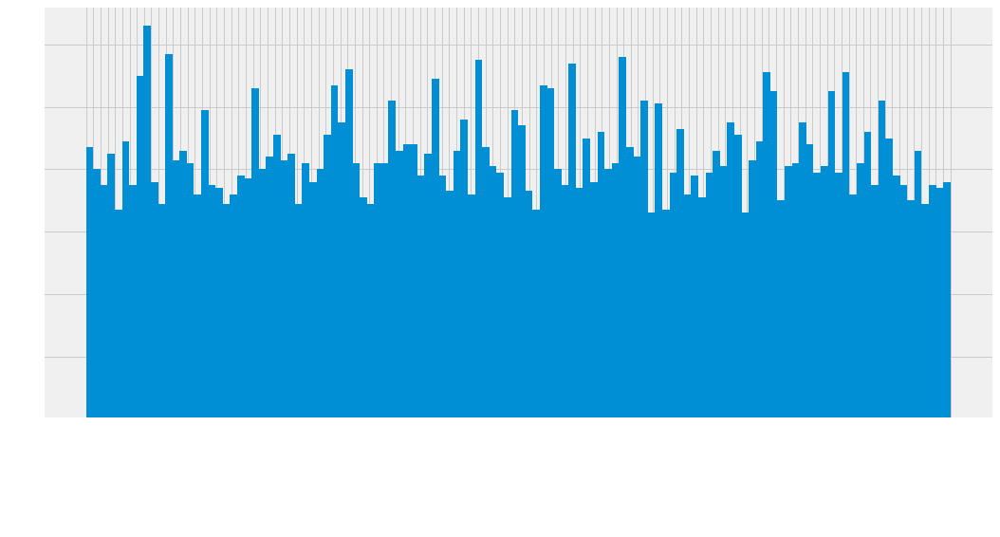

In [64]:
hist = labeled_data['breed'].hist(figsize=(16, 8), bins=120, xrot=90, xlabelsize=8)
print("Labeled images class distribution")
plt.show()

<h4>Uneven data problem</h4>
Since we have an uneven data for each label, we can expect that the learning process will be harder on some of the samples more than other.
<p> We need to overcome this by weighting our labels relative to their presence in the dataset to avoid diversion.</p>

<h3>Further data analysis</h3>
<p>
We can see that the train samples from each label varies.</br>
We want to understand the amount and dimensions of our image data better
</p>

In [65]:
from PIL import Image

widths, heights = [], []

for filename in labeled_data['id']:
    image = Image.open(join(train_dir, filename))
    widths.append(image.size[0]) # width
    heights.append(image.size[1]) # height

print('Training data average (width, height): ', (np.mean(widths), np.mean(heights)))
print('Training data (minimum width, maximum width): ', (np.min(widths), np.max(widths)))
print('Training data (minimum height, maximum height): ', (np.min(heights), np.max(heights)))
print('Training data (Standart deviation of widths, Standart deviation of heights): ', (np.std(widths), np.std(heights)))

Training data average (width, height):  (443.33153981608297, 386.74721189591077)
Training data (minimum width, maximum width):  (97, 3264)
Training data (minimum height, maximum height):  (102, 2562)
Training data (Standart deviation of widths, Standart deviation of heights):  (152.41266408441547, 130.06196422027517)


<h4>Plot the distribution of images class count and images widths heights</h4>

Labeled images widths and heights distribution


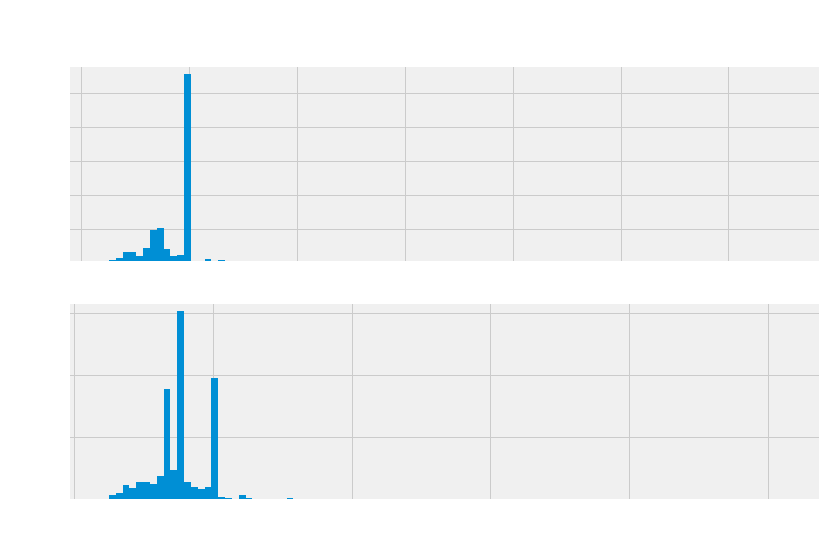

In [84]:
fig, (ax1, ax2) = plt.subplots(2, figsize=(12, 8))
fig.suptitle('Histograms of training image widths, heights')
 
ax1.hist(widths, bins=100); ax1.set_xlabel('Width'); ax1.set_ylabel('No. of images')
ax2.hist(heights, bins=100); ax2.set_xlabel('Height'); ax2.set_ylabel('No. of images')
 
print("Labeled images widths and heights distribution")
plt.show()

<h4>Uneven data dimensions</h4>
We can see that our images dimension varies, we will need to resize the samples before passing them to our model

<h3>1.d. Simillar Datasets Benchmarks</h3>
<p>
The following articles are strongly related to the problem that we are trying to solve here.<br/>
Although they don't not use the exact same dog breed dataset, they use a dog breed data set that has a label count simillar to ours and mostly use transfer learning techniques.<br/>
<a href="https://web.stanford.edu/class/cs231a/prev_projects_2016/output%20(1).pdf">Dog Breed Identification - Stanford University</a><br/>
<a href="http://blizzard.cs.uwaterloo.ca/iss4e/wp-content/uploads/2017/10/yerbol_aussat_cs698_project_report.pdf">Dog Breed Identification - University of Waterloo</a><br/>
<a href="https://edu.codespring.ro/wp-content/uploads/2019/06/Sniff_SISY_2018.pdf">Dog Breed Identification - ResearchGate</a><br/>
</p>
<p>
The following tables and charts show a comparison of results gotten using different known CNN models to solve a simillar dog-identification problem:<br/>
We can see the metrics for train and validation data with and without augmentation.
</p>


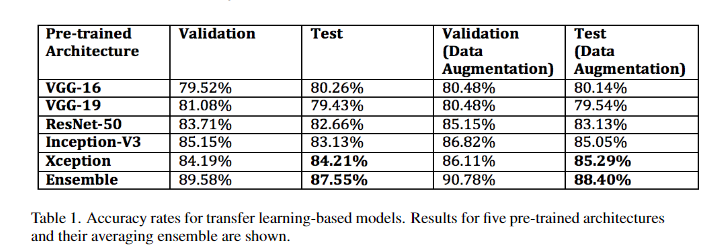


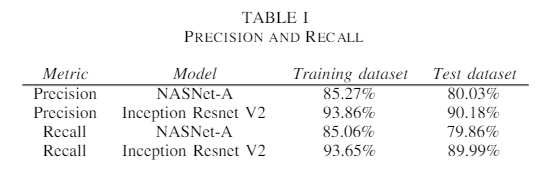


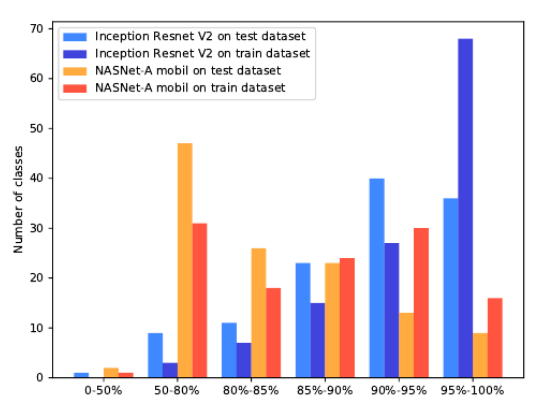

In [20]:
display_image("benchmark.png")
display_image("benchmark3.png")
display_image("benchmark2.png")

<h3>1.e. Plot samples from our dog breed image samples</h3>

In [42]:
from mpl_toolkits.axes_grid1 import ImageGrid

def plot_multiple_imgs_by_class(imgs, labels, nrows=10, ncols=12, figsize=(18, 18)):
    fig = plt.figure(1, figsize=figsize)
    grid = ImageGrid(fig, 111, nrows_ncols=(nrows, ncols), axes_pad=0.05)
    for i in range(nrows * ncols):
        ax = grid[i]
        ax.imshow(imgs[i] / 255.)
        ax.axis('off')
        ax.text(0, 0, '%s' % labels[i], color='k', backgroundcolor='w', alpha=0.8)
    plt.tight_layout()

def read_and_resize_single_img(filename, nrow=224, ncol=224, channels=3):
    arr = cv2.imread(filename)
    arr = cv2.cvtColor(arr, cv2.COLOR_RGB2BGR)
    arr = cv2.resize(arr,dsize=(nrow,ncol)) # Need to resize image since the dimensions of the images not uniform
    return arr

def read_train_from_dirs(data_path, num_imgs=120, nrow=224, ncol=224, channels=3):
    filenames = labeled_data['id'].tolist()
    random.shuffle(filenames)
    imgs = []
    for filename in filenames[:num_imgs]:
        label_row = labeled_data.loc[labeled_data['id'] == filename]['breed']
        label = label_row.iloc[0]
        imgs.append((join(train_dir, filename), label))

    X = np.zeros((num_imgs,nrow,ncol,channels))
    for i, img in enumerate(imgs):
        arr = read_and_resize_single_img(img[0],nrow,ncol,channels)
        X[i] = np.float16(arr)
    return X, [img[1] for img in imgs]

C:\Users\Itay Bouganim\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:11: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  # This is added back by InteractiveShellApp.init_path()


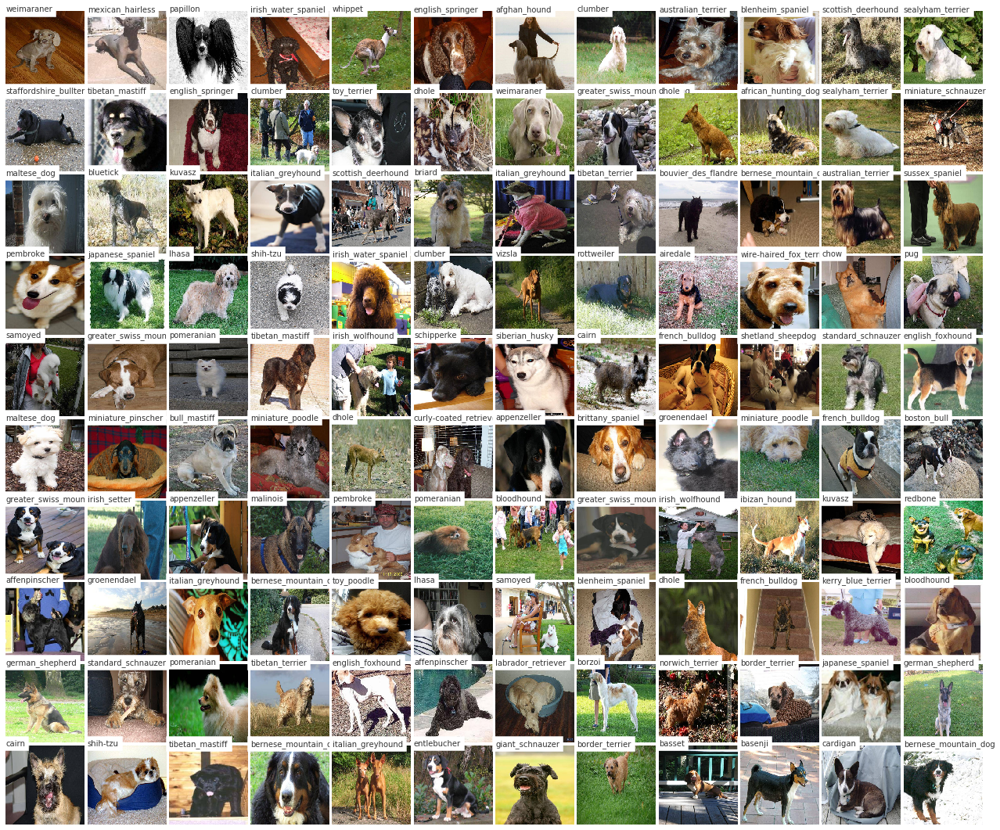

In [123]:
imgs, labels = read_train_from_dirs(data_path=train_dir)
plot_multiple_imgs_by_class(imgs, labels=labels)

<h3> From a brief examination of the data we can see that it varies</h3>
<ul>
<li>Some of the samples contain more than just dogs, sometimes humans and somtimes objects</li>
<li>Some of the samples contain more than one dog in it</li>
<li>The samples show different sides of the dogs and in many different viewing angles, Some of the samples contain only heads and some full body.</li>
<li>Some of the samples contain a lot of scenery where some focus mainly on the dog</li>
<li>Many of the dog breed are hard to distinguish even by humans.</li>
</ul>

<p>
    All of those factors and the fact that this is a relatively small dataset for 120 labels, can make the training process harder and need to be taken into account.
</p>

<h3>Distinguisable samples</h3>
   


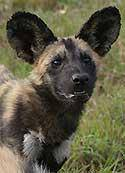


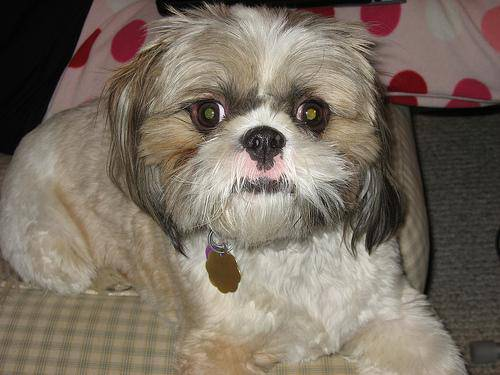

In [15]:
display_image("african.jpg", label="African Hunting Dog")
display_image("shitzu.jpg", label="Shi-Tzu")

<h4>Hard to distinguish samples</h4>


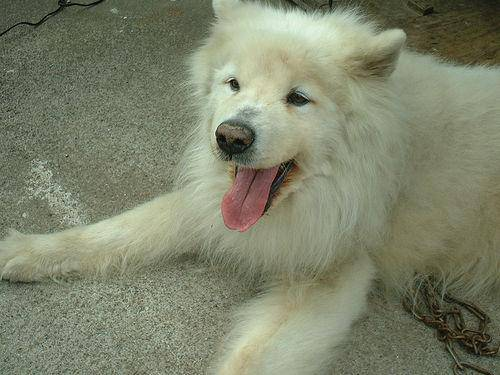


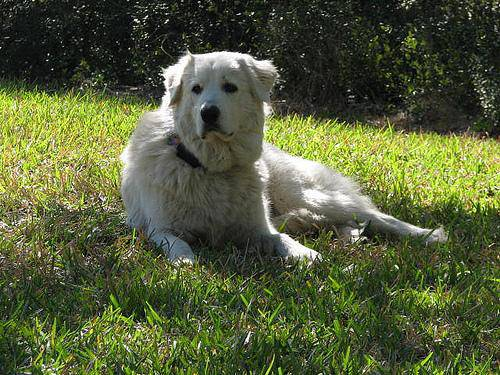

In [16]:
display_image("samoyed.jpg", label="Samoyed")
display_image("great.jpg", label="Great Pyrenees")

<h4>Dog Focus differences</h4>


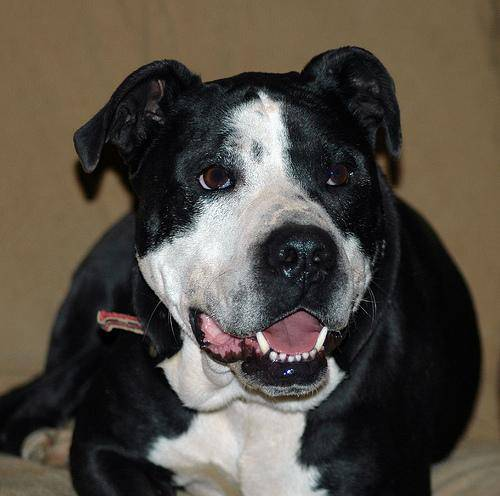


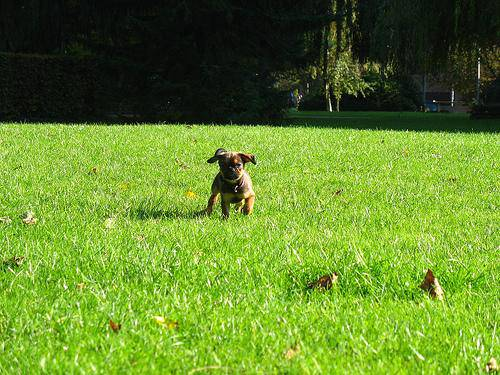

In [17]:
display_image("face.jpg", label="Mainly Face")
display_image("scene.jpg", label="Mainly Scenery")

<h4>Showing not only dogs</h4>


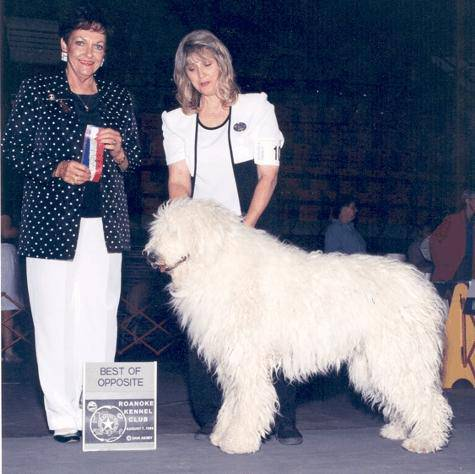

In [18]:
display_image("humans.jpg", label="")


<h4>Obstucted by noticable items</h4>



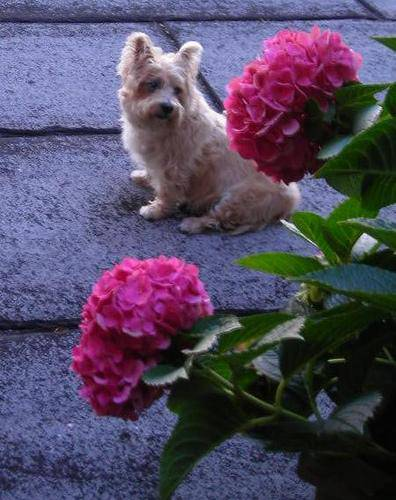

In [19]:
display_image("obstuct.jpg", label="")

<h2>2. Create simple CNN model to try and solve the problem</h2>
<h3>We will use the KFold cross validation technique with K = 5</h3>

<h3>2.a. KFold</h3>
In k-fold cross-validation, the original sample is randomly partitioned into k equal sized subsamples. Of the k subsamples,<br/> a single subsample is retained as the validation data for testing the model, and the remaining k − 1 subsamples are used as training data.<br/> The cross-validation process is then repeated k times, with each of the k subsamples used exactly once as the validation data.<br/> The k results can then be averaged to produce a single estimation.


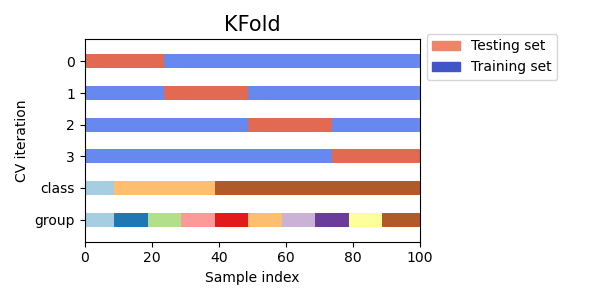

In [22]:
display_image("kfold.png")

In [7]:
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Input, MaxPool2D, Dropout, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [8]:
def one_hot_encode(y):
    y = np.array([label_to_index[label] for label in y])
    enc = np.zeros((y.size, y.max() + 1))
    enc[np.arange(y.size), y] = 1
    return enc

In [221]:
def create_model(optimizer):
    inp = Input((128, 128, 3))
    
    # Block 1
    x = Conv2D(16,(3, 3), activation='relu')(inp)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 2
    x = Conv2D(32,(3, 3), activation='relu')(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 3
    x = Conv2D(48,(3, 3), activation='relu')(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Fully Connected
    x = Flatten()(x)
    x = Dense(64, activation='relu')(x)
    x = Dense(120, activation='softmax')(x)

    model = Model(inputs=inp, outputs=x)
    model.compile(loss='categorical_crossentropy',optimizer=optimizer, metrics=['accuracy'])
    return model

create_model('adam').summary()

Model: "functional_219"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_110 (InputLayer)       [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d_446 (Conv2D)          (None, 126, 126, 16)      448       
_________________________________________________________________
max_pooling2d_424 (MaxPoolin (None, 63, 63, 16)        0         
_________________________________________________________________
conv2d_447 (Conv2D)          (None, 61, 61, 32)        4640      
_________________________________________________________________
max_pooling2d_425 (MaxPoolin (None, 30, 30, 32)        0         
_________________________________________________________________
conv2d_448 (Conv2D)          (None, 28, 28, 48)        13872     
_________________________________________________________________
max_pooling2d_426 (MaxPoolin (None, 14, 14, 48)     

In [9]:
from sklearn.model_selection import KFold
from sklearn.utils import class_weight

k = 5

def generate_kfold(X, Y, k=5):
    kf = KFold(n_splits=k)

    folds = []
    for idx, (train_index, val_index) in enumerate(kf.split(X, Y)):
        training_data = labeled_data.iloc[train_index]
        validation_data = labeled_data.iloc[val_index]
        
        folds.append({'train': training_data, 'valid': validation_data})
        print(f"Fold {idx + 1} => train count: {len(folds[idx]['train'])}, valid count: {len(folds[idx]['valid'])}")
        print(folds[idx]['valid'].groupby(['breed']).agg(['count']))
    return folds

In [223]:
folds = generate_kfold(np.zeros(train_count), Y_train)

Fold 1 => train count: 8177, valid count: 2045
                                  id
                               count
breed                               
affenpinscher                     19
afghan_hound                      21
african_hunting_dog               13
airedale                          23
american_staffordshire_terrier    13
...                              ...
welsh_springer_spaniel            22
west_highland_white_terrier       17
whippet                           22
wire-haired_fox_terrier           10
yorkshire_terrier                 20

[120 rows x 1 columns]
Fold 2 => train count: 8177, valid count: 2045
                                  id
                               count
breed                               
affenpinscher                     15
afghan_hound                      19
african_hunting_dog               19
airedale                          23
american_staffordshire_terrier    11
...                              ...
welsh_springer_spaniel         

In [10]:
BATCH_SIZE = 20

In [11]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

model_save_dir = join(data_dir, 'saved_models')

def get_callbacks(saved_model_name):
    early_stopping_callback = EarlyStopping(monitor="val_loss", patience=8, verbose=2)
    checkpoint_callback = ModelCheckpoint(join(model_save_dir, f'model_{saved_model_name}.h5'), 
                                                monitor='val_loss', verbose=1, 
                                                save_best_only=True, mode='min')
    return [early_stopping_callback, checkpoint_callback]

In [226]:
def train_simple_cnn_model(folds, optimizer, image_generator, epochs, dims):
    hist = []
    for idx, fold in enumerate(folds):
        print(f'\n\nFitting model with fold no. {idx + 1}')
        train_data_generator = image_generator.flow_from_dataframe(dataframe=fold['train'],target_size=dims, directory=train_dir,
                                x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                    shuffle = True, batch_size=BATCH_SIZE)
        valid_data_generator = image_generator.flow_from_dataframe(dataframe=fold['valid'], target_size=dims, directory=train_dir,
                                x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                    shuffle = True, batch_size=BATCH_SIZE)

        callbacks = get_callbacks(saved_model_name=f'cnn_fold{idx}')
        model = create_model(optimizer)
        history = model.fit(x=train_data_generator, validation_data=valid_data_generator, callbacks=callbacks, epochs=epochs, verbose=2)
        hist.append(history)
    return hist

In [227]:
cnn_history = train_simple_cnn_model(folds=folds, optimizer='adam', image_generator=ImageDataGenerator(), epochs=20, dims=images_shape)



Fitting model with fold no. 1
Found 8177 validated image filenames belonging to 120 classes.
Found 2045 validated image filenames belonging to 120 classes.
Epoch 1/20

Epoch 00001: val_accuracy improved from -inf to 0.00929, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_cnn_fold0.h5
409/409 - 27s - loss: 5.1871 - accuracy: 0.0102 - val_loss: 4.7860 - val_accuracy: 0.0093
Epoch 2/20

Epoch 00002: val_accuracy improved from 0.00929 to 0.01125, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_cnn_fold0.h5
409/409 - 21s - loss: 4.7837 - accuracy: 0.0099 - val_loss: 4.7852 - val_accuracy: 0.0112
Epoch 3/20

Epoch 00003: val_accuracy did not improve from 0.01125
409/409 - 22s - loss: 4.7811 - accuracy: 0.0126 - val_loss: 4.7849 - val_accuracy: 0.0112
Epoch 4/20

Epoch 00004: val_accuracy did not improve from 0.01125
409/409 - 21s -

In [36]:
def plot_model_fold_stats(k, history):
    fig, ax = plt.subplots(k, 2,figsize=(15,20))
    print(ax.shape)
    for i, h in enumerate(history):
        ax[i][0].plot(h.history['accuracy'])
        ax[i][0].plot(h.history['val_accuracy'])
        ax[i][0].set_title(f'Model accuracy fold no. {i + 1}')
        ax[i][0].set_ylabel('Accuracy')
        ax[i][0].set_xlabel('Epoch')
        ax[i][0].legend(['Train', 'Valid'], loc='upper left')

        # Plot training & validation loss values
        ax[i][1].plot(h.history['loss'])
        ax[i][1].plot(h.history['val_loss'])
        ax[i][1].set_title(f'Model loss fold no. {i + 1}')
        ax[i][1].set_ylabel('Loss')
        ax[i][1].set_xlabel('Epoch')
        ax[i][1].legend(['Train', 'Valid'], loc='upper left')

    fig.tight_layout(pad=3.0)
    plt.show()

(5, 2)


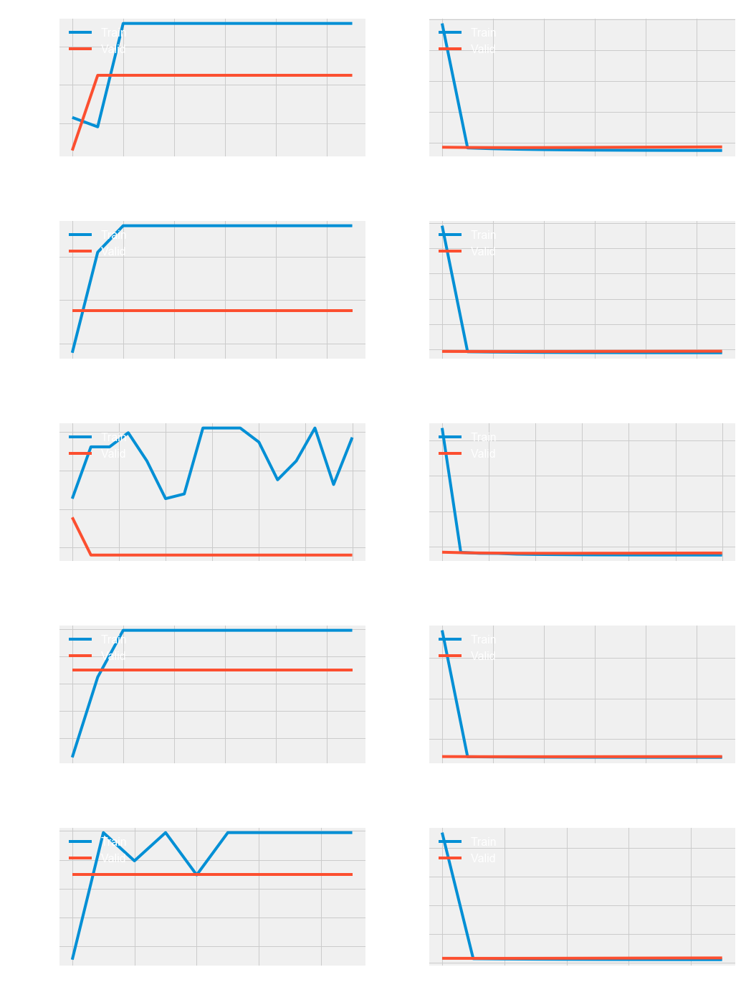

In [229]:
plot_model_fold_stats(k=k, history=cnn_history)

In [12]:
import statistics 

def print_model_last_epoch_stats(history):
    final_acc = [acc for sublist in list(h.history['accuracy'][-1:] for h in history) for acc in sublist]
    print(f"Mean fold accuracy: {round(statistics.mean(final_acc) * 100, 2)}%")

    final_loss = [acc for sublist in list(h.history['loss'][-1:] for h in history) for acc in sublist]
    print(f"Mean fold loss: {statistics.mean(final_loss)}")

    valid_final_acc = [acc for sublist in list(h.history['val_accuracy'][-1:] for h in history) for acc in sublist]
    print(f"Mean fold validation accuracy: {round(statistics.mean(valid_final_acc) * 100, 2)}%")

    valid_final_loss = [acc for sublist in list(h.history['val_loss'][-1:] for h in history) for acc in sublist]
    print(f"Mean fold validation loss: {statistics.mean(valid_final_loss)}")
    

In [ ]:
print_model_last_epoch_stats(history=cnn_history)

<h4>We can see that our naive model approach did not work</h4>
<p>
The model did not manage to memorize the data, and the validation results are almost entirly random.
Lets suggest a few ways that can possibly improve that.
</p>

<h3>2.b. Suggested ways to improve towards second iteration</h3>
<ul>
<li>Increase model complexity by adding 2 more convolutional layers</li>
<li>Add 2 more dense layer to increase parameters count to better identify features</li>
<li>Add batch normalization after each convultional layer to help coordinate the update of multiple layers in the model (leads to higher learning rate and better speed)</li>
</ul>

In [23]:
def create_model_2(optimizer):
    inp = Input((128, 128, 3))
    
    # Block 1
    x = Conv2D(16,(3, 3), activation='relu')(inp)
    x = BatchNormalization(axis=3)(x) # Added batch normalization after each convolutional layer
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 2
    x = Conv2D(32,(3, 3), activation='relu')(x)
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 3
    x = Conv2D(48,(3, 3), activation='relu')(x) # Added 2 more convultional layers with filters sizes 48 and 64
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 4
    x = Conv2D(64,(3, 3), activation='relu')(x)
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Fully Connected
    x = Flatten()(x)
    x = Dense(1024, activation='relu')(x) # Added 2 more fully connected 1D layers with sizes 1024 and 512 respectively
    x = Dense(512, activation='relu')(x)
    x = Dense(256, activation='relu')(x)
    x = Dense(120, activation='softmax')(x)

    model = Model(inputs=inp, outputs=x)
    model.compile(loss='categorical_crossentropy',optimizer=optimizer, metrics=['accuracy'])
    return model

create_model_2('adam').summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 126, 126, 16)      448       
_________________________________________________________________
batch_normalization (BatchNo (None, 126, 126, 16)      64        
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 63, 63, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 61, 61, 32)        4640      
_________________________________________________________________
batch_normalization_1 (Batch (None, 61, 61, 32)        128       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 30, 30, 32)       

In [13]:
train_folds = generate_kfold(np.zeros(train_count), Y_train)

Fold 1 => train count: 8177, valid count: 2045
                                  id
                               count
breed                               
affenpinscher                     19
afghan_hound                      21
african_hunting_dog               13
airedale                          23
american_staffordshire_terrier    13
...                              ...
welsh_springer_spaniel            22
west_highland_white_terrier       17
whippet                           22
wire-haired_fox_terrier           10
yorkshire_terrier                 20

[120 rows x 1 columns]
Fold 2 => train count: 8177, valid count: 2045
                                  id
                               count
breed                               
affenpinscher                     15
afghan_hound                      19
african_hunting_dog               19
airedale                          23
american_staffordshire_terrier    11
...                              ...
welsh_springer_spaniel         

In [15]:
def train_simple_cnn_model2(folds, optimizer, image_generator, epochs, dims):
    hist = []
    for idx, fold in enumerate(folds):
        print(f'\n\nFitting model with fold no. {idx + 1}')
        train_data_generator = image_generator.flow_from_dataframe(dataframe=fold['train'],target_size=dims, directory=train_dir,
                                x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                    shuffle = True, batch_size=BATCH_SIZE)
        valid_data_generator = image_generator.flow_from_dataframe(dataframe=fold['valid'], target_size=dims, directory=train_dir,
                                x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                    shuffle = True, batch_size=BATCH_SIZE)

        callbacks = get_callbacks(saved_model_name=f'simple_cnn_fold{idx}')
        model = create_model_2(optimizer)
        history = model.fit(x=train_data_generator, validation_data=valid_data_generator, callbacks=callbacks, epochs=epochs, verbose=2)
        hist.append(history)
    return hist

In [82]:
simple_cnn_history = train_simple_cnn_model2(folds=train_folds, optimizer='adam', image_generator=ImageDataGenerator(), epochs=20, dims=images_shape)



Fitting model with fold no. 1
Found 8177 validated image filenames belonging to 120 classes.
Found 2045 validated image filenames belonging to 120 classes.
Epoch 1/20

Epoch 00001: val_accuracy improved from -inf to 0.01711, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_simple_cnn_fold0.h5
409/409 - 21s - loss: 4.7070 - accuracy: 0.0241 - val_loss: 5.2388 - val_accuracy: 0.0171
Epoch 2/20

Epoch 00002: val_accuracy improved from 0.01711 to 0.03961, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_simple_cnn_fold0.h5
409/409 - 22s - loss: 4.4005 - accuracy: 0.0472 - val_loss: 4.4872 - val_accuracy: 0.0396
Epoch 3/20

Epoch 00003: val_accuracy improved from 0.03961 to 0.05379, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_simple_cnn_fold0.h5
409/4

(5, 2)


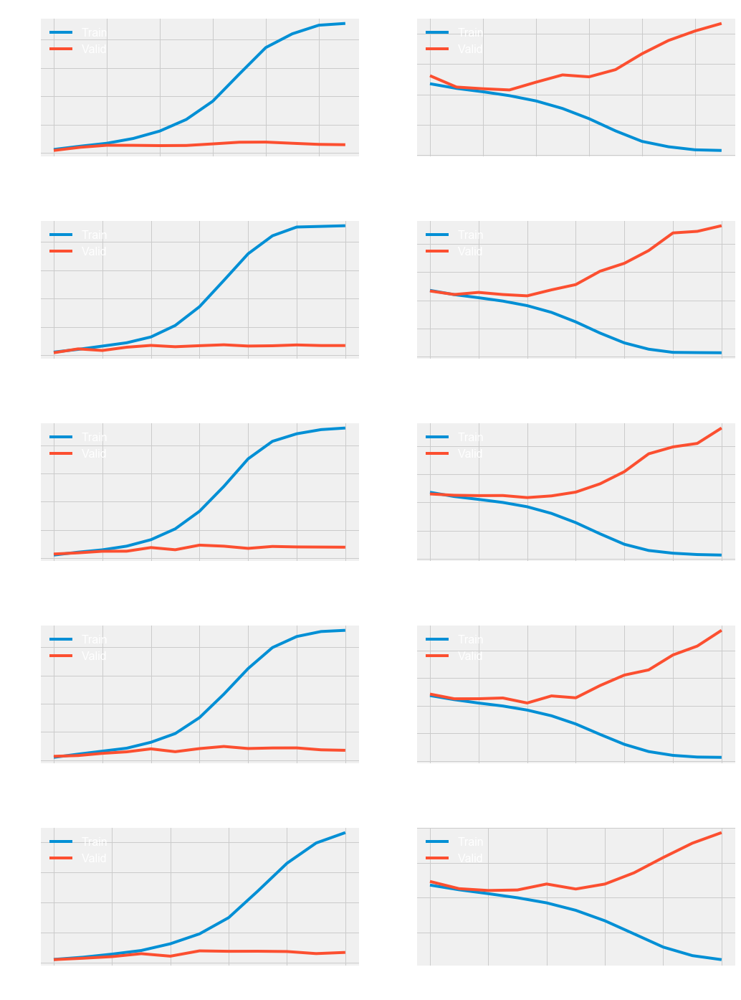

In [86]:
plot_model_fold_stats(k=k, history=simple_cnn_history)

<h4>We can see that we encouter <b>overfitting</b> problem since the train accuracy increases while the validation loss stops increasing at an early stage.</h4>

In [108]:
print_model_last_epoch_stats(history=simple_cnn_history)

Mean fold accuracy: 90.73%
Mean fold loss: 31.3%
Mean fold validation accuracy: 6.87%
Mean fold validation loss: 889.21%


<h4>Simple CNN model iteration 2 - Confusion Matrix</h4>
<p>
plot confusion matrix to try and get a visual idea of how our second model classified our labeled data</br>
Since we do not have labeled test data in this dataset, we will use one of the models trained in a fold and use the labeled validation data as the true labels.
</p>

In [16]:
import itertools

def plot_confusion_matrix(cm, labels, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.figure(figsize = (28,28))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    plt.grid(None)
    tick_marks = np.arange(len(labels))
    plt.xticks(tick_marks, labels, rotation=90)
    plt.yticks(tick_marks, labels)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

In [17]:
from sklearn.metrics import confusion_matrix
from collections import Counter
from functools import cmp_to_key

def calculate_model_metrics(saved_model_prefix, create_model_func, folds, dims, preprocess_func=lambda s: s, dtype=np.uint8, fold_i=None):
    fold_idx = random.choice(range(len(folds))) if fold_i is None else fold_i
    fold = folds[fold_idx]['valid']
    model = create_model_func()
    model.load_weights(join(model_save_dir, f"model_{saved_model_prefix}{fold_idx}.h5"))
    X = np.zeros((fold.shape[0], dims, dims, 3), dtype=dtype)
    for i in range(fold.shape[0]):
        X[i] = preprocess_func(cv2.resize(cv2.imread(join(train_dir, f"{fold['id'].iloc[i]}")), (dims, dims)))
    
    y_pred = model.predict(X)
    y_enc = one_hot_encode(fold['breed'].to_numpy())
    y_pred_classes = np.argmax(y_pred,axis = 1)
    y_true = np.argmax(y_enc, axis=1)

    y_pred_labeled = [{'pred_label': index_to_label[pred], 'true_label': index_to_label[y_true[i]],
                      'filename': fold['id'].iloc[i], 'perc': np.amax(y_pred[i])} for i, pred in enumerate(y_pred_classes)]
    correct_pred = list(filter(lambda pred: pred['pred_label'] == pred['true_label'], y_pred_labeled))
    worst_wrong_pred = sorted(list(filter(lambda pred: pred['pred_label'] != pred['true_label'], y_pred_labeled)), key=lambda e: e['perc'], reverse=True)[:10]
    correct_perc = len(correct_pred) / fold.shape[0]
    return {'confusion':confusion_matrix(y_true, y_pred_classes), 'correct': sorted(correct_pred, key=lambda e: e['perc'], reverse=True)[:10],
            'wrong': worst_wrong_pred, 'correct_perc': correct_perc}


In [18]:
def read_and_plot_correct_wrong(correct, wrong):
    num_imgs = len(correct)
    def read_imgs(lst, is_samples=False):
        filter_lst = list(e['filename'] if not is_samples else e for e in lst)
        X = np.zeros((num_imgs,224,224,3))
        for i, img in enumerate(filter_lst):
            arr = read_and_resize_single_img(join(train_dir, img.iloc[0] if is_samples else img),224,224,4)
            X[i] = np.float16(arr)
        return X
    
    correct_imgs = read_imgs(correct)
    wrong_imgs = read_imgs(wrong)
    
    wrongs_true_breeds = list(wrong[i]['pred_label'] for i in range(num_imgs))
    wrong_true_sample_filenames = [labeled_data.loc[labeled_data['breed'] == breed].sample()['id'] for breed in wrongs_true_breeds]
    wrong_true_samples = read_imgs(wrong_true_sample_filenames, is_samples=True)
        
    fig = plt.figure(1, figsize=(35, 5))
    fig.suptitle('Correct Predictions - TOP 10 HIGHEST %', fontsize=20)
    grid = ImageGrid(fig, 111, nrows_ncols=(1, num_imgs), axes_pad=0.05)
    for i in range(num_imgs):
        ax = grid[i]
        ax.imshow(correct_imgs[i] / 255.)
        ax.axis('off')
        ax.text(0, 0, 'True label', color='white', backgroundcolor='green', alpha=0.8, fontsize=13)
        ax.text(0, 20, '%s' % correct[i]['true_label'], color='k', backgroundcolor='w', alpha=0.8, fontsize=13)
        ax.text(0, 224, 'Predicted label', color='white', backgroundcolor='green', alpha=0.8, fontsize=13)
        ax.text(0, 244, '%s - %s' % (correct[i]['pred_label'], round((correct[i]['perc'] * 100), 2)) + '%' , color='k', backgroundcolor='w', alpha=0.8, fontsize=13)
    plt.show()
    
    fig = plt.figure(1, figsize=(35, 8))
    fig.suptitle('Wrong Predictions - TOP 10 HIGHEST %', fontsize=20)
    grid = ImageGrid(fig, 111, nrows_ncols=(2, num_imgs), axes_pad=0.05)
    for i in range(num_imgs * 2):
        ax = grid[i]
        ax.axis('off')
        if(i < num_imgs):
            ax.imshow(wrong_imgs[i] / 255.)
            ax.text(0, 0, 'True label', color='white', backgroundcolor='green', alpha=0.8, fontsize=13)
            ax.text(0, 20, '%s' % wrong[i]['true_label'], color='k', backgroundcolor='w', alpha=0.8, fontsize=13)
        else:
            ax.imshow(wrong_true_samples[i - num_imgs] / 255.)
            ax.text(0, 0, 'Predicted label', color='white', backgroundcolor='red', alpha=0.8, fontsize=13)
            ax.text(0, 20, '%s - %s' % (wrong[i - num_imgs]['pred_label'], round((wrong[i - num_imgs]['perc'] * 100), 2)) + '%' , color='k', backgroundcolor='w', alpha=0.8, fontsize=13)
    plt.show()

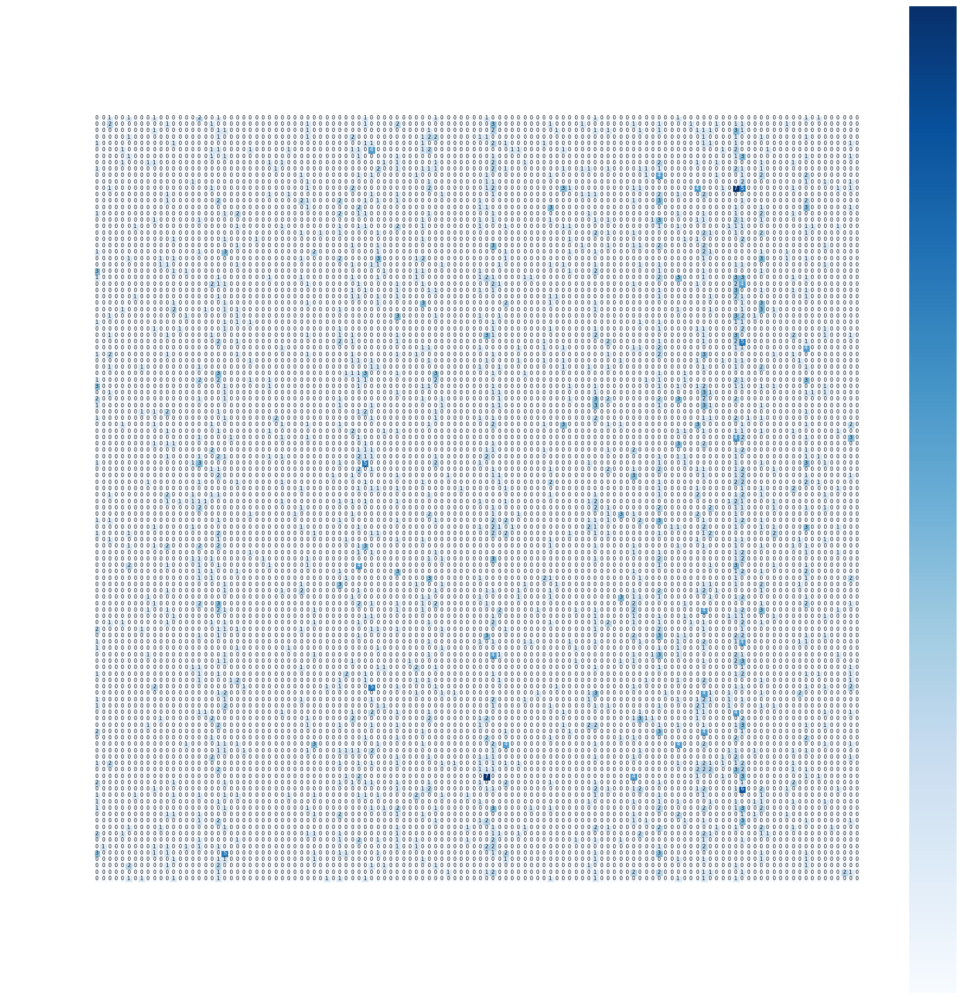

In [24]:
simple_cnn_metrics = calculate_model_metrics(saved_model_prefix='simple_cnn_fold', dims=128, create_model_func=lambda : create_model_2('adam'), folds=train_folds)
plot_confusion_matrix(simple_cnn_metrics['confusion'], labels=labels, title="Confusion Matrix Simple CNN 2") 

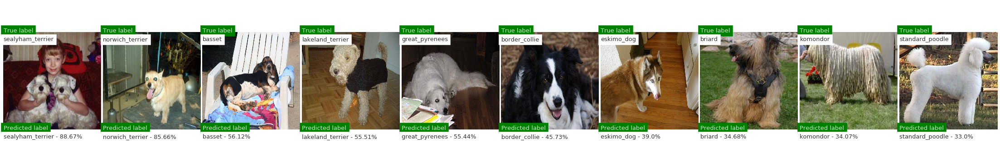

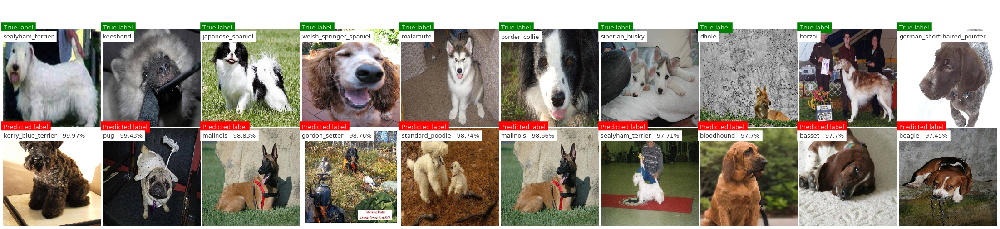

In [135]:
read_and_plot_correct_wrong(correct=simple_cnn_metrics['correct'], wrong=simple_cnn_metrics['wrong'])

In [29]:
print('Correct percentage: {}%'.format(round(simple_cnn_metrics['correct_perc'] * 100, 2)))

Correct percentage: 0.83%


<h4>Classification examples</h4>

In [19]:
from tqdm import tqdm
import cv2

sample_submission = pd.read_csv(join(data_dir, 'sample_submission.csv'))
submission_columns = sample_submission[sample_submission.columns.difference(['id'])].columns

def get_test_samples(preprocess_func, dims, dtype=np.uint8):
    print(f"Loading test data\n")
    X_test = np.zeros((test_count, dims, dims, 3), dtype=dtype)
    print(X_test.shape)
    test_ids = []
    for i in tqdm(range(test_count)):
        X_test[i] = preprocess_func(cv2.resize(cv2.imread(join(test_dir, f"{sample_submission['id'][i]}.jpg")), (dims, dims)))
        test_ids.append(sample_submission['id'][i])
    return X_test, test_ids

In [318]:
def get_prediction_dataframes(X_test, test_ids, dims, saved_model_prefix, create_model_func):
    dataframes = []
    for fold_idx in range(k):
        print(f"Loading best model for fold no. {fold_idx + 1}")
        model = create_model_func()
        model.load_weights(join(model_save_dir, f"{saved_model_prefix}{fold_idx}.h5"))
        predictions = model.predict(X_test, batch_size=BATCH_SIZE, verbose=2)
        submission_res = pd.DataFrame(data=predictions, index=test_ids, columns=np.array([*label_to_index]))
        submission_res = submission_res.sort_index(axis=1)
        submission_res.index.name = 'id'
        dataframes.append(submission_res)
    return dataframes

<h3>Prepare kaggle submission CSV file </h3>

In [319]:
def create_submission_file(X_test, test_ids, name, dims, saved_model_prefix, create_model_func):
    submission_res = pd.concat(get_prediction_dataframes(X_test, test_ids, dims=dims, saved_model_prefix=saved_model_prefix, create_model_func=create_model_func)).groupby(level=0).mean()
    submission_res.to_csv(join(data_dir, name), encoding='utf-8', index=True)
    submission_data = pd.read_csv(join(data_dir, name))
    return submission_data

In [349]:
X_test, test_ids = get_test_samples(preprocess_func=lambda s: s, dims=128)
submission_data = create_submission_file(X_test=X_test, test_ids=test_ids, name='simple_submission.csv', dims=128, saved_model_prefix='model_simple_cnn_fold', create_model_func= lambda : create_model_2('adam'))
submission_data

  0%|                                                                                                                                                             | 4/10357 [00:00<04:36, 37.48it/s]

Loading test data

(10357, 128, 128, 3)


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10357/10357 [00:53<00:00, 192.08it/s]


Loading best model for fold no. 1
518/518 - 3s
Loading best model for fold no. 2
518/518 - 3s
Loading best model for fold no. 3
518/518 - 3s
Loading best model for fold no. 4
518/518 - 3s
Loading best model for fold no. 5
518/518 - 3s


,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,0.000064,0.004077,0.000197,0.001823,0.004612,0.001564,0.000410,0.000113,0.000862,...,0.000790,0.000590,0.005122,0.013338,0.000745,0.000027,0.007362,0.004491,0.000181,0.000116
1,00102ee9d8eb90812350685311fe5890,0.008168,0.000020,0.013558,0.000009,0.001243,0.000093,0.000035,0.000024,0.000277,...,0.001595,0.000021,0.000094,0.003868,0.000035,0.000003,0.000047,0.000908,0.000003,0.000017
2,0012a730dfa437f5f3613fb75efcd4ce,0.000865,0.000585,0.000101,0.001102,0.027626,0.000494,0.000003,0.002172,0.000261,...,0.022721,0.001998,0.000423,0.003136,0.000510,0.000269,0.004785,0.030969,0.001300,0.000009
3,001510bc8570bbeee98c8d80c8a95ec1,0.000871,0.010698,0.004396,0.006734,0.004085,0.005849,0.018347,0.027267,0.020501,...,0.012595,0.001418,0.005316,0.003150,0.002536,0.000408,0.002017,0.007825,0.003881,0.000873
4,001a5f3114548acdefa3d4da05474c2e,0.000061,0.000360,0.000121,0.005975,0.000643,0.001025,0.040158,0.000345,0.032338,...,0.000926,0.000005,0.001153,0.000258,0.000741,0.000013,0.000191,0.002294,0.000898,0.000357
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10352,ffeda8623d4eee33c6d1156a2ecbfcf8,0.002060,0.001003,0.000372,0.000033,0.002026,0.000056,0.000078,0.000231,0.000318,...,0.000683,0.000036,0.000031,0.003062,0.000019,0.000006,0.000385,0.013999,0.000052,0.000004
10353,fff1ec9e6e413275984966f745a313b0,0.000110,0.005332,0.000157,0.019785,0.002992,0.004356,0.003990,0.014155,0.001546,...,0.005515,0.000543,0.003767,0.000547,0.022557,0.001472,0.002641,0.020190,0.004028,0.001797
10354,fff74b59b758bbbf13a5793182a9bbe4,0.000167,0.006971,0.000238,0.005577,0.001246,0.007994,0.005057,0.000968,0.001030,...,0.009600,0.000198,0.006677,0.000267,0.001035,0.000287,0.008515,0.001153,0.000754,0.001159
10355,fff7d50d848e8014ac1e9172dc6762a3,0.000567,0.000924,0.000229,0.000023,0.005878,0.000066,0.000010,0.000336,0.000009,...,0.001927,0.000003,0.009985,0.001471,0.000082,0.000009,0.000271,0.000077,0.000004,0.000004


<h3>Kaggle multiclass loss score: 7.06920</h3>
<h4>Lower is better</h4>

<h2>2.c.Misclassification Causes</h2>
<p>
We can see that are model misclassifies mainly because of overfitting,<br/>
The improvements that will improve us the most are improvements that will fight the overfitting problem<br/>
while keeping our model training time reasonable.
    </p>
<h2> Ways to further improve the model towards third iteration</h2>
<ul>
    <li> Add dropout layers to avoid memorization of features in the model and to try and decrease overfitting problem</li>
    <li> Increase input shape ((128, 128, 3) => (224, 224, 3)) to better preserve original samples features</li>
    <li> Increase model complexity by adding convolutional layers to try and better represent sample features </li>
    <li> Use data augmentation to increase the sample count of training data and to better generalize the available training data</li>
    <li> Use stratisifed KFold to avoid diversions caused by uneven sample count per label and to better represent the label distirbution in each fold</li>
    <li> Deacrease optimizer learning rate (1e<sup>-2</sup> => 1e<sup>-3</sup>) to increase reliability in gradient decent convergence</li>
    <li> Increase epoch count to try and acheive covergence due to the decreased learning rate (20 => 40 epochs) and usage of dropout layers</li>
    <li> Normalize the samples pixel values to range [0, 1] to increase the models convergence speed in order to compensate the now decresed learning rate</li>
    <li> Add global average pooling layer before dense layer to try and pass average features to fully-connected layers </li>
</ul>

<h3>Stratified KFold</h3>
In stratified k-fold cross-validation, the partitions are selected so that the mean response value is approximately equal in all the partitions.<br/> In the case of binary classification, this means that each partition contains roughly the same proportions of the two types of class labels.


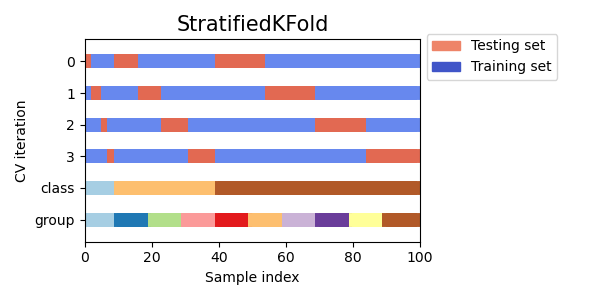

In [23]:
display_image("statisfied.png")

<h4>Use Stratisfied KFold to better represent the label distirbution in each fold</h4>
By doing that we will be able to see that each breed is represented in the fold relative to the total sample count from that breed in total training data

In [20]:
from sklearn.model_selection import KFold, StratifiedKFold

def generate_weighted_kfold(X, Y, k=5):
    kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=1)

    folds = []
    for idx, (train_index, val_index) in enumerate(kf.split(X, Y)):
        training_data = labeled_data.iloc[train_index]
        validation_data = labeled_data.iloc[val_index]
        
        folds.append({'train': training_data, 'valid': validation_data})
        print(f"Fold {idx + 1} => train count: {len(folds[idx]['train'])}, valid count: {len(folds[idx]['valid'])}")
        print(folds[idx]['valid'].groupby(['breed']).agg(['count']))
    return folds

train_weighted_folds = generate_weighted_kfold(np.zeros(train_count), Y_train)

Fold 1 => train count: 8177, valid count: 2045
                                  id
                               count
breed                               
affenpinscher                     16
afghan_hound                      23
african_hunting_dog               17
airedale                          21
american_staffordshire_terrier    15
...                              ...
welsh_springer_spaniel            16
west_highland_white_terrier       17
whippet                           19
wire-haired_fox_terrier           17
yorkshire_terrier                 16

[120 rows x 1 columns]
Fold 2 => train count: 8177, valid count: 2045
                                  id
                               count
breed                               
affenpinscher                     16
afghan_hound                      23
african_hunting_dog               17
airedale                          21
american_staffordshire_terrier    15
...                              ...
welsh_springer_spaniel         

<h4>Improve our model from previous iteration to address the improvement suggestions mentioned above</h4>

<h3>2.d. Simple CNN model improvement</h3>
<p>
The goal is to address the suggestions for improvement suggested above to overcome the overfitting problem we encountered in the first iteration of the model
</p>

In [29]:
# Add dropout layers in the fully connected layers to avoid overfitting
def create_improved_model(optimizer):
    inp = Input((224, 224, 3)) # increased expected input size to better preserve features
    
    # Block 1
    x = Conv2D(16,(3, 3), activation='relu')(inp)
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 2
    x = Conv2D(32,(3, 3), activation='relu')(x)
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 3
    x = Conv2D(64,(3, 3), activation='relu')(x)
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 4
    x = Conv2D(128,(3, 3), activation='relu')(x) # Added 128 filters convolutional layer and removed 48 filters layer to preserve exponential filter dimensions growth consistency
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    
    # Block 5
    x = Conv2D(256,(3, 3), activation='relu')(x) # Added 256 filters convolutional layer
    x = BatchNormalization(axis=3)(x)
    x = MaxPool2D(pool_size=(2,2), strides=2)(x)
    x = GlobalAveragePooling2D()(x) # Added global average pooling before dense layer
    
    # Fully Connected
    x = Flatten()(x)
    x = Dropout(0.5)(x) # Added dropout layers to avoid memorization of feature in dense layer (due to overfitting in previous model)
    x = Dense(512, activation='relu')(x) # removed fully connected layer with size 1024 to decrease parameter count to try make the learning process quicker
    x = Dropout(0.5)(x)
    x = Dense(256, activation='relu')(x)
    x = Dense(120, activation='softmax')(x)

    model = Model(inputs=inp, outputs=x)
    model.compile(loss='categorical_crossentropy',optimizer=optimizer, metrics=['accuracy'])
    return model

create_improved_model('adam').summary()

Model: "functional_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 222, 222, 16)      448       
_________________________________________________________________
batch_normalization_30 (Batc (None, 222, 222, 16)      64        
_________________________________________________________________
max_pooling2d_26 (MaxPooling (None, 111, 111, 16)      0         
_________________________________________________________________
conv2d_31 (Conv2D)           (None, 109, 109, 32)      4640      
_________________________________________________________________
batch_normalization_31 (Batc (None, 109, 109, 32)      128       
_________________________________________________________________
max_pooling2d_27 (MaxPooling (None, 54, 54, 32)      

In [22]:
large_image_size = (224, 224)

rescale_gen = ImageDataGenerator(rescale=1./255) # normalize input to 0-1 to increase convergence speed

In [23]:
BATCH_SIZE = 20

def train_improved_simple_cnn_model(folds, train_image_generator, valid_image_generator, epochs, dims, prefix='improved'):
    hist = []
    for idx, fold in enumerate(folds):
        print(f'\n\nFitting model with fold no. {idx + 1}')
        train_data_generator = train_image_generator.flow_from_dataframe(dataframe=fold['train'], target_size=dims, directory=train_dir,
                                x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                    shuffle = True, batch_size=BATCH_SIZE)
        valid_data_generator = valid_image_generator.flow_from_dataframe(dataframe=fold['valid'], target_size=dims, directory=train_dir,
                                x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                    shuffle = True, batch_size=BATCH_SIZE)

        callbacks = get_callbacks(saved_model_name=f'{prefix}_simple_cnn_fold{idx}')
        model = create_improved_model(optimizer=Adam(learning_rate=0.001)) # lowered learning rate from default for Adam(=0.01) to 0.001
        history = model.fit(x=train_data_generator, validation_data=valid_data_generator, callbacks=callbacks, epochs=epochs, verbose=2)
        hist.append(history)
    return hist

In [30]:
# Increased the epoch count to 40 and lowered learning rate to try and converge in more iterations without diverging
improved_cnn_history = train_improved_simple_cnn_model(folds=train_weighted_folds, train_image_generator=rescale_gen, valid_image_generator=rescale_gen, epochs=40, dims=large_image_size)



Fitting model with fold no. 1
Found 8177 validated image filenames belonging to 120 classes.
Found 2045 validated image filenames belonging to 120 classes.
Epoch 1/40

Epoch 00001: val_loss improved from inf to 4.78216, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_improved_simple_cnn_fold0.h5
409/409 - 33s - loss: 4.8001 - accuracy: 0.0192 - val_loss: 4.7822 - val_accuracy: 0.0137
Epoch 2/40

Epoch 00002: val_loss improved from 4.78216 to 4.70106, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_improved_simple_cnn_fold0.h5
409/409 - 34s - loss: 4.6245 - accuracy: 0.0295 - val_loss: 4.7011 - val_accuracy: 0.0249
Epoch 3/40

Epoch 00003: val_loss did not improve from 4.70106
409/409 - 35s - loss: 4.4822 - accuracy: 0.0364 - val_loss: 4.7314 - val_accuracy: 0.0274
Epoch 4/40

Epoch 00004: val_loss improved from 4.70106 to 4.49

(5, 2)


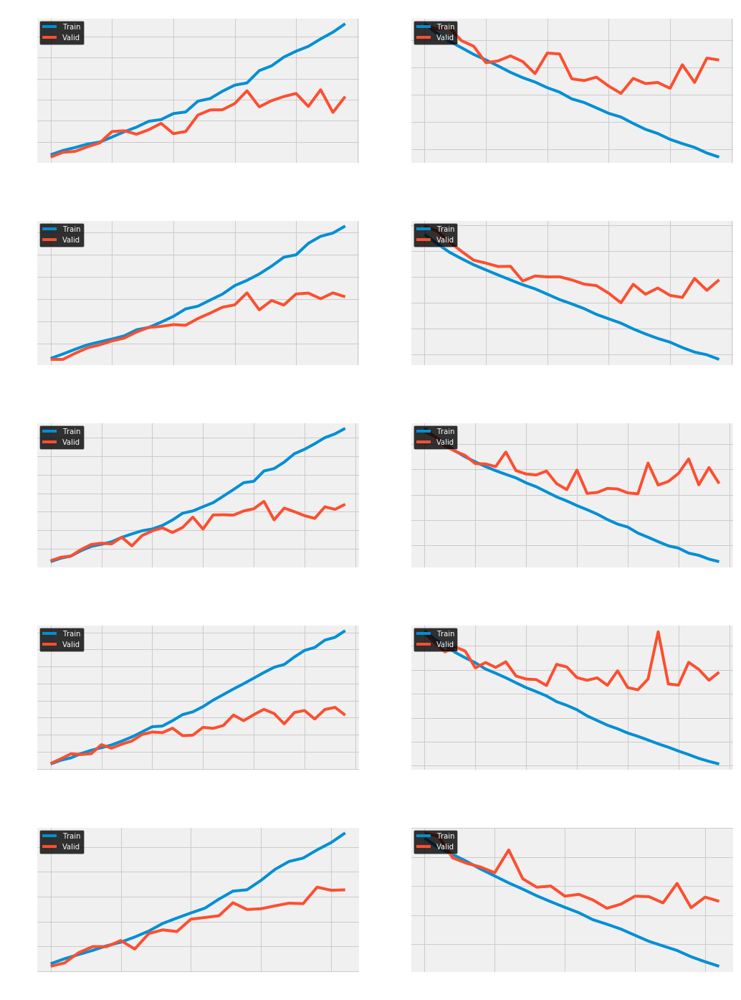

In [37]:
plot_model_fold_stats(k=k, history=improved_cnn_history)

In [38]:
print_model_last_epoch_stats(history=improved_cnn_history)

Mean fold accuracy: 34.07%
Mean fold loss: 2.3148712635040285
Mean fold validation accuracy: 16.07%
Mean fold validation loss: 3.8972976207733154


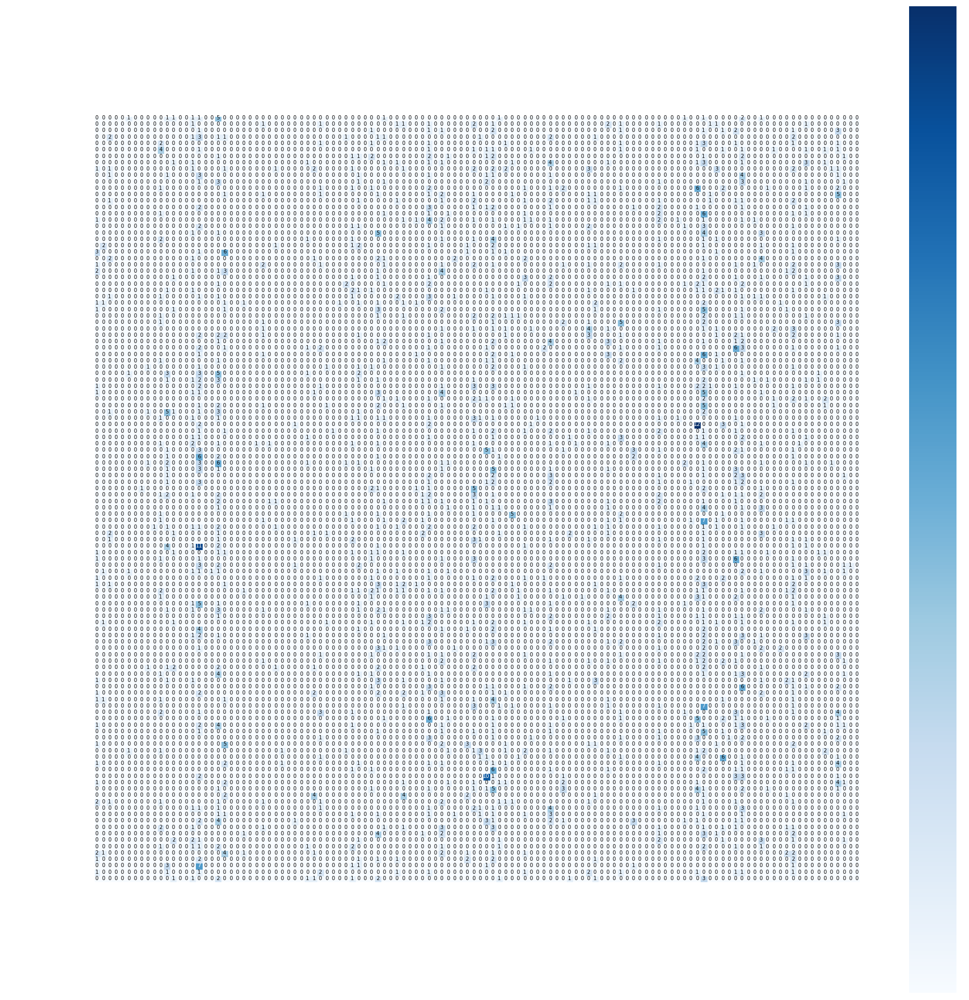

In [39]:
improved_cnn_metrics = calculate_model_metrics(saved_model_prefix='improved_simple_cnn_fold', dims=224, 
                                                      create_model_func=lambda : create_improved_model('adam'), folds=train_weighted_folds, preprocess_func=lambda s: s / 255., dtype=np.float64)
plot_confusion_matrix(improved_cnn_metrics['confusion'], labels=labels, title="Confusion Matrix Simple CNN Improved") 

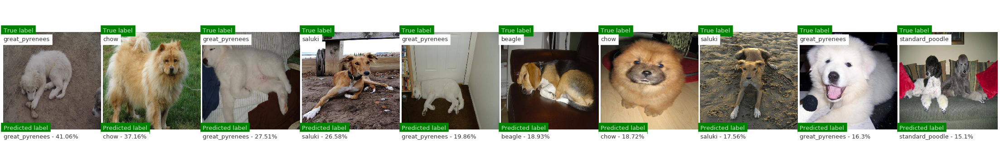

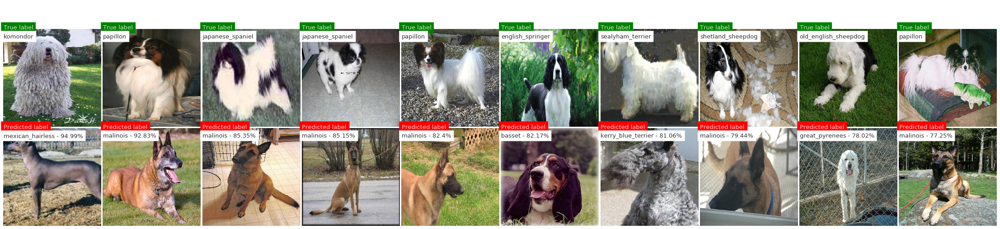

In [43]:
read_and_plot_correct_wrong(correct=improved_cnn_metrics['correct'], wrong=improved_cnn_metrics['wrong'])

In [55]:
print('Correct percentage: {}%'.format(round(improved_cnn_metrics['correct_perc'] * 100, 2)))

Correct percentage: 0.78%


<h4>Overall we see that the model still overfits at a later epoch of the training but in a less drastic way than our previous iteration, when it comes to classification, our model still under-performs due to the limited samples for each label</h4>

<h4>Create Kaggle submission file</h4>

In [320]:
X_test, test_ids = get_test_samples(preprocess_func=lambda s: s / 255., dims=224, dtype=np.float64)

  0%|▏                                                                             | 31/10357 [00:00<01:10, 147.22it/s]

Loading test data

(10357, 224, 224, 3)


100%|███████████████████████████████████████████████████████████████████████████| 10357/10357 [01:18<00:00, 132.57it/s]


In [321]:
submission_data = create_submission_file(X_test=X_test, test_ids=test_ids, name='improved_submission.csv', dims=224,
                                         saved_model_prefix='model_improved_simple_cnn_fold', create_model_func= lambda : create_improved_model('adam'))
submission_data

Loading best model for fold no. 1
518/518 - 13s
Loading best model for fold no. 2
518/518 - 15s
Loading best model for fold no. 3
518/518 - 18s
Loading best model for fold no. 4
518/518 - 22s
Loading best model for fold no. 5
518/518 - 24s


,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,2.144512e-05,0.000619,9.317542e-06,0.001857,0.000400,6.070149e-04,2.666213e-06,2.615361e-05,0.002010,...,0.000356,9.400729e-07,0.004305,0.003872,0.000013,3.195044e-07,0.008729,0.002631,3.375650e-05,0.000002
1,00102ee9d8eb90812350685311fe5890,4.442798e-04,0.000004,4.429980e-04,0.000005,0.000160,1.774236e-07,1.793715e-10,4.919388e-06,0.000045,...,0.000298,1.043975e-05,0.001048,0.002818,0.000119,1.280820e-05,0.000003,0.000085,3.426826e-08,0.000002
2,0012a730dfa437f5f3613fb75efcd4ce,1.669309e-04,0.002639,3.984945e-05,0.002367,0.061110,4.573074e-04,3.831987e-06,3.432477e-04,0.000472,...,0.000768,1.688881e-03,0.003052,0.043348,0.002629,3.905412e-05,0.049086,0.000904,1.180893e-04,0.000055
3,001510bc8570bbeee98c8d80c8a95ec1,1.320521e-04,0.001885,1.316597e-04,0.022206,0.001052,2.322877e-03,1.018113e-02,1.459216e-02,0.004484,...,0.004191,1.340324e-04,0.009578,0.000485,0.000659,3.277568e-05,0.005122,0.011622,8.496747e-04,0.000119
4,001a5f3114548acdefa3d4da05474c2e,1.348277e-03,0.001121,2.766325e-03,0.009323,0.001741,8.960483e-04,5.960839e-04,3.535169e-04,0.012484,...,0.018997,6.132192e-05,0.009744,0.004944,0.000255,3.128378e-05,0.000807,0.005180,1.498030e-04,0.000252
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10352,ffeda8623d4eee33c6d1156a2ecbfcf8,4.779456e-06,0.000519,4.553959e-07,0.001600,0.003222,4.333176e-04,1.052073e-07,2.387645e-05,0.000086,...,0.000107,6.005065e-05,0.001522,0.093911,0.000135,1.871218e-06,0.027570,0.000236,2.302135e-05,0.000011
10353,fff1ec9e6e413275984966f745a313b0,8.374298e-03,0.008866,4.927144e-03,0.047773,0.001810,9.137831e-03,4.319807e-04,3.216693e-01,0.002868,...,0.004483,6.017507e-04,0.000142,0.000196,0.002199,7.602975e-04,0.000150,0.010798,6.029317e-03,0.000300
10354,fff74b59b758bbbf13a5793182a9bbe4,1.007527e-04,0.020113,3.443260e-05,0.037717,0.000610,3.737891e-04,4.820871e-03,2.312609e-03,0.002277,...,0.000920,5.485362e-06,0.003570,0.000640,0.000126,9.018207e-07,0.001463,0.003648,3.090318e-04,0.000025
10355,fff7d50d848e8014ac1e9172dc6762a3,2.010942e-07,0.000054,1.408543e-08,0.000093,0.004617,1.225257e-04,1.582808e-07,1.704731e-09,0.000007,...,0.002025,1.222511e-05,0.046217,0.012860,0.000017,4.603556e-06,0.011885,0.000131,8.309052e-05,0.000008


<h3>Kaggle multiclass loss score: 6.61512</h3>
<h4>Lower is better</h4>

<h2>2.e. Inference Time Data Augmantation</h2>
<h3>Use data augmentation on the training data to increase total training samples and to better generalize the input</h3>

In [31]:
# Apply data augmentation to train samples to increase available data
aug_image_gen = ImageDataGenerator(rescale=1./255, # normalize input to 0-1 to increase convergence speed
        shear_range=0.2,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        fill_mode='nearest',
        zoom_range=0.2,
        horizontal_flip=True)
        
valid_image_gen = ImageDataGenerator(rescale=1./255)

As we can see, we chose to use preety loose augmentation settings on our dataset due to its small size.<br/>
We will use 40 deg rotation, zoom of up to 20%, height and width shifts of up to 20%, shear of up to 20% and horizontal flipping.

<h4>Plot a sample of the augmentation result on a single random sample</h4>

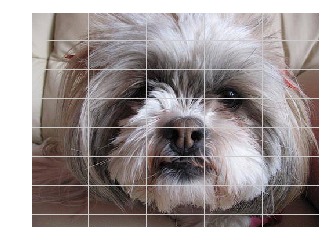

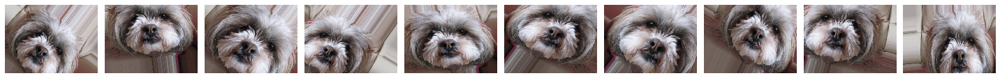

In [329]:
rand_train_image = random.choice(os.listdir(train_dir))
img = np.expand_dims(plt.imread(join(train_dir, rand_train_image)), 0)
plt.imshow(img[0])
aug_images = [(next(aug_image_gen.flow(img))[0]  * 255).astype(np.uint8) for i in range(15)]

flg, axes = plt.subplots(1, 10, figsize=(20,20))
axes = axes.flatten()
for img, ax in zip(aug_images, axes):
    ax.imshow(img)
    ax.axis('off')
plt.tight_layout()
plt.show()

In [32]:
improved_cnn_history_aug = train_improved_simple_cnn_model(folds=train_weighted_folds, train_image_generator=aug_image_gen, valid_image_generator=valid_image_gen, epochs=40, dims=large_image_size, prefix="augment")



Fitting model with fold no. 1
Found 8177 validated image filenames belonging to 120 classes.
Found 2045 validated image filenames belonging to 120 classes.
Epoch 1/40

Epoch 00001: val_loss improved from inf to 4.79580, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_augment_simple_cnn_fold0.h5
409/409 - 109s - loss: 4.8297 - accuracy: 0.0147 - val_loss: 4.7958 - val_accuracy: 0.0156
Epoch 2/40

Epoch 00002: val_loss improved from 4.79580 to 4.60787, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_augment_simple_cnn_fold0.h5
409/409 - 104s - loss: 4.6937 - accuracy: 0.0220 - val_loss: 4.6079 - val_accuracy: 0.0225
Epoch 3/40

Epoch 00003: val_loss did not improve from 4.60787
409/409 - 103s - loss: 4.5791 - accuracy: 0.0301 - val_loss: 4.8431 - val_accuracy: 0.0152
Epoch 4/40

Epoch 00004: val_loss improved from 4.60787 to 4.5

(5, 2)


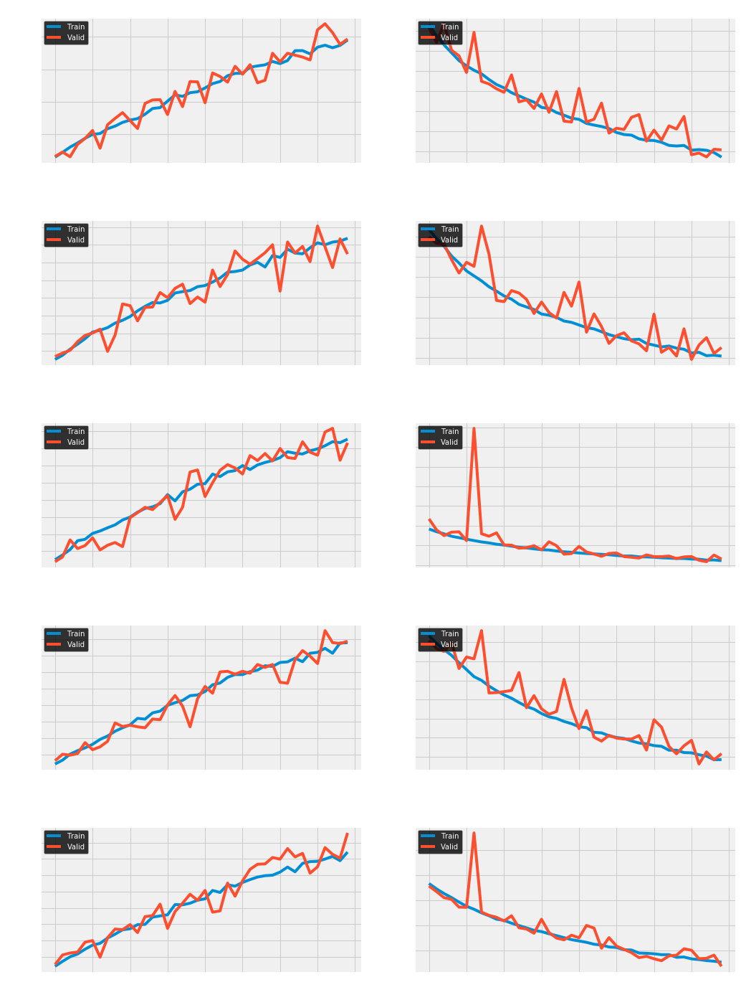

In [45]:
plot_model_fold_stats(k=k, history=improved_cnn_history_aug)

In [46]:
print_model_last_epoch_stats(history=improved_cnn_history_aug)

Mean fold accuracy: 18.96%
Mean fold loss: 3.23105731010437
Mean fold validation accuracy: 19.07%
Mean fold validation loss: 3.285396909713745


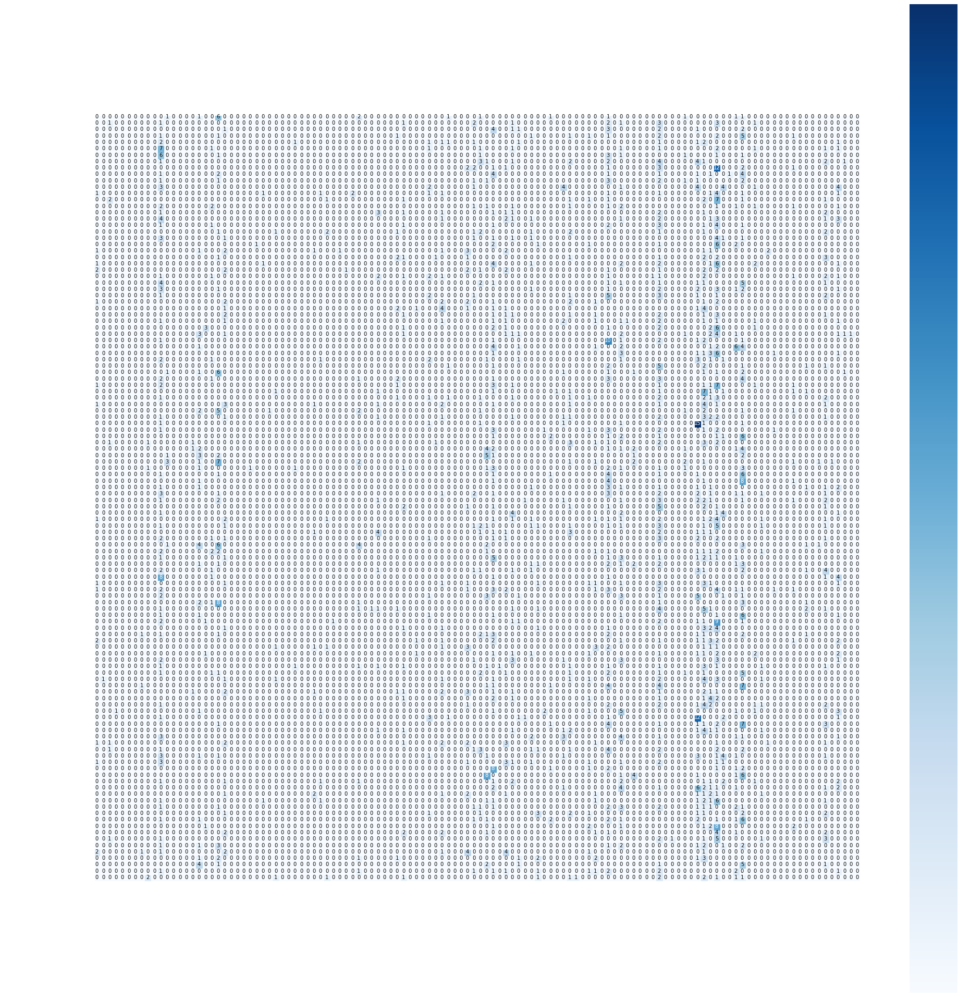

In [56]:
improved_cnn_aug_metrics = calculate_model_metrics(saved_model_prefix='augment_simple_cnn_fold', dims=224, 
                                                      create_model_func=lambda : create_improved_model('adam'), folds=train_weighted_folds, preprocess_func=lambda s: s / 255., dtype=np.float64)
plot_confusion_matrix(improved_cnn_aug_metrics['confusion'], labels=labels, title="Confusion Matrix Simple CNN Improved with Augmentation") 

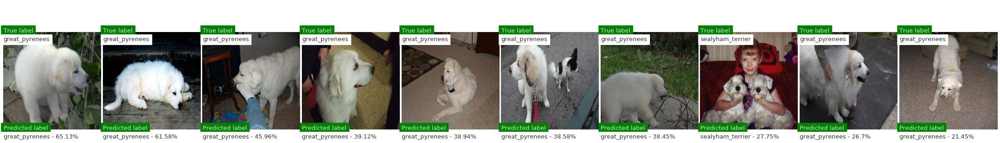

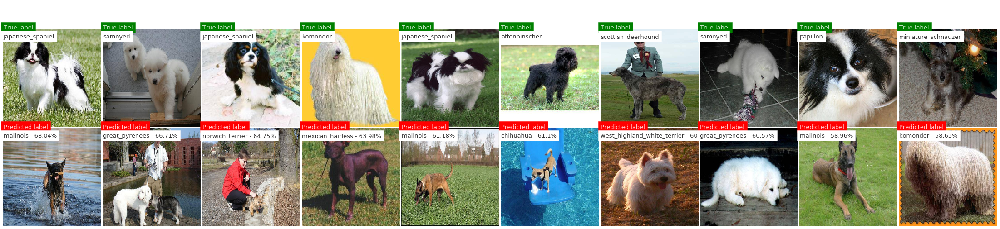

In [57]:
read_and_plot_correct_wrong(correct=improved_cnn_aug_metrics['correct'], wrong=improved_cnn_aug_metrics['wrong'])

In [59]:
print('Correct percentage: {}%'.format(round(improved_cnn_aug_metrics['correct_perc'] * 100, 2)))

Correct percentage: 1.13%


<h4>We can see that using data augmentation improved our overall results, possibly with more epochs of training this simple model will be able to lower the train/validation loss.</h4>

In [60]:
def retrain_improved_model_augmentation(epochs):
    model = create_improved_model(optimizer=Adam(learning_rate=0.001))
    model.load_weights(join(model_save_dir, f"model_augment_simple_cnn_fold0.h5"))
    callbacks = get_callbacks(saved_model_name=f'augment_simple_cnn_retrain0')
    train_data_generator = aug_image_gen.flow_from_dataframe(dataframe=train_weighted_folds[0]['train'], target_size=large_image_size, directory=train_dir,
                            x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                shuffle = True, batch_size=BATCH_SIZE)
    valid_data_generator = valid_image_gen.flow_from_dataframe(dataframe=train_weighted_folds[0]['valid'], target_size=large_image_size, directory=train_dir,
                            x_col = 'id', y_col = 'breed', class_mode = "categorical",
                                shuffle = True, batch_size=BATCH_SIZE)
    return model.fit(x=train_data_generator, validation_data=valid_data_generator, callbacks=callbacks, epochs=epochs, verbose=2)

In [61]:
improved_cnn_history_aug_retrain = retrain_improved_model_augmentation(epochs=20)

Found 8177 validated image filenames belonging to 120 classes.
Found 2045 validated image filenames belonging to 120 classes.
Epoch 1/20

Epoch 00001: val_loss improved from inf to 3.25478, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_augment_simple_cnn_retrain0.h5
409/409 - 134s - loss: 3.2492 - accuracy: 0.1887 - val_loss: 3.2548 - val_accuracy: 0.2205
Epoch 2/20

Epoch 00002: val_loss improved from 3.25478 to 3.21507, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_augment_simple_cnn_retrain0.h5
409/409 - 123s - loss: 3.2047 - accuracy: 0.1898 - val_loss: 3.2151 - val_accuracy: 0.2225
Epoch 3/20

Epoch 00003: val_loss did not improve from 3.21507
409/409 - 126s - loss: 3.1980 - accuracy: 0.1975 - val_loss: 3.2302 - val_accuracy: 0.2054
Epoch 4/20

Epoch 00004: val_loss did not improve from 3.21507
409/409 - 123s - loss: 3.

In [64]:
def plot_model_stats(h):
    fig, ax = plt.subplots(2, 1,figsize=(10,10))
    ax[0].plot(h.history['accuracy'])
    ax[0].plot(h.history['val_accuracy'])
    ax[0].set_title(f'Model accuracy')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_xlabel('Epoch')
    ax[0].legend(['Train', 'Valid'], loc='upper left')

    # Plot training & validation loss values
    ax[1].plot(h.history['loss'])
    ax[1].plot(h.history['val_loss'])
    ax[1].set_title(f'Model loss')
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('Epoch')
    ax[1].legend(['Train', 'Valid'], loc='upper left')

    fig.tight_layout(pad=3.0)
    plt.show()

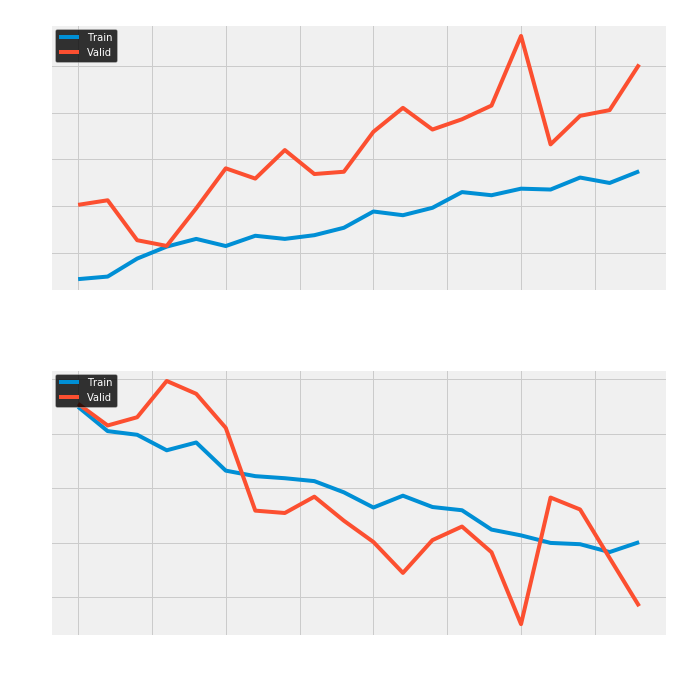

In [66]:
plot_model_stats(improved_cnn_history_aug_retrain)

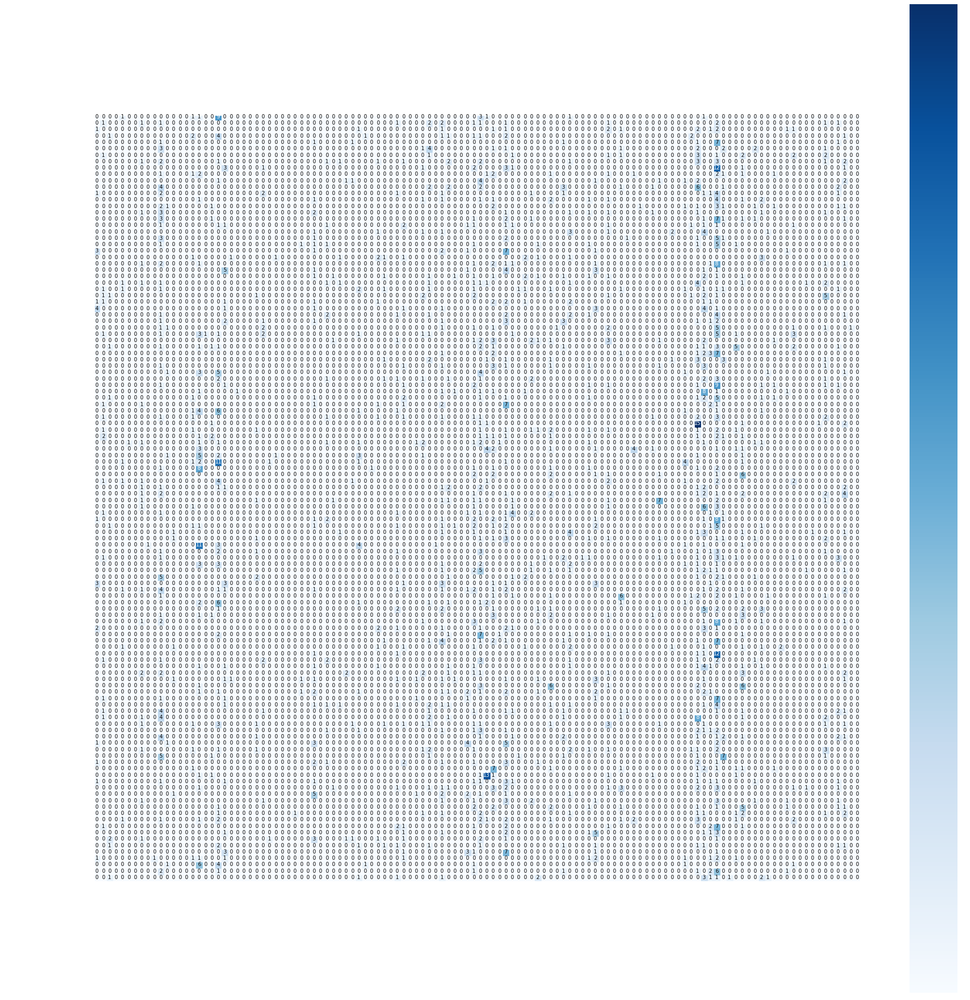

In [72]:
improved_cnn_aug_metrics_retrain = calculate_model_metrics(saved_model_prefix='augment_simple_cnn_retrain', dims=224, 
                                                      create_model_func=lambda : create_improved_model('adam'), folds=train_weighted_folds, preprocess_func=lambda s: s / 255., dtype=np.float64, fold_i=0)
plot_confusion_matrix(improved_cnn_aug_metrics_retrain['confusion'], labels=labels, title="Confusion Matrix Simple CNN Improved with Augmentation - Second run (Ttoal 80 epochs)") 

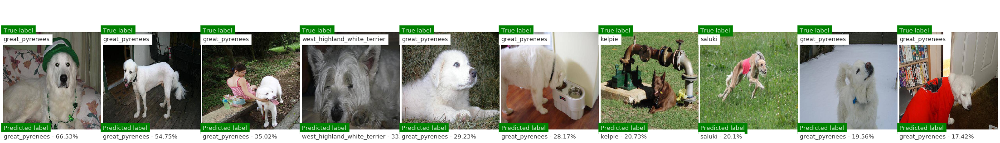

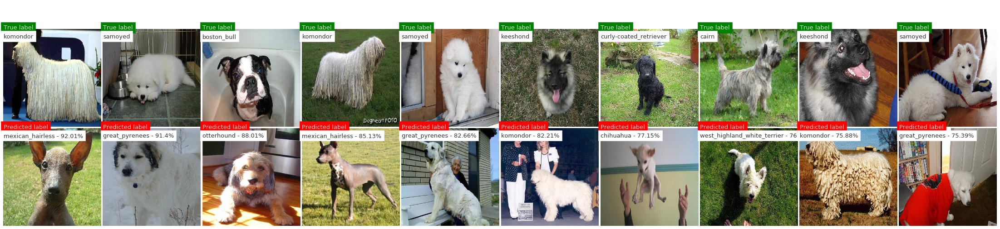

In [76]:
read_and_plot_correct_wrong(correct=improved_cnn_aug_metrics_retrain['correct'], wrong=improved_cnn_aug_metrics_retrain['wrong'])

We can see by the samples that we got a small improvement in terms of classification.<br/> The correct samples predcitions % went up and some of the wrong predictions can be tricky to seperate between.

In [77]:
print('Correct percentage: {}%'.format(round(improved_cnn_aug_metrics_retrain['correct_perc'] * 100, 2)))

Correct percentage: 1.03%


<h4>Create Kaggle submission file</h4>

In [ ]:
X_test, test_ids = get_test_samples(preprocess_func=lambda s: s / 255., dims=224, dtype=np.float64)

In [ ]:
submission_data = create_submission_file(X_test=X_test, test_ids=test_ids, name='improved_augmentation_submission.csv', dims=224,
                                         saved_model_prefix='model_augment_simple_cnn_fold', create_model_func= lambda : create_improved_model('adam'))
submission_data

<h4>What is the cause for the validation accuracy being greater than training accuracy?</h4>
We can observe that we acheive validation accuracy >= training accuracy some of the times.</br>
This may be caused due to the added model dropout layers, A possible explanation would be:</br>
<p>
Due to disabling neurons, some of information about each sample is lost, and the subsequent layers attempt to construct the answers basing on incomplete representations.</p><p> The training loss is higher because we've probably made it artificially harder for the network to give the right answers. However, during validation all of the neurons are available, so the network has its full computational power - and thus it might perform better than in training.
</p>

<h4>Overall we see that the model does not overfit but still does not perform as we would like it to be,<br/> After 60 epochs total it still seems to converge and validation loss decreases, possibly with more epochs we will be able to acheive better results</h4>

<h3>Kaggle multiclass loss score: 4.11512</h3>
<h4>Lower is better</h4>

<h2>3. Transfer learning using InceptionV3</h2>
In this section we are going to use transfer learning techniques to solve our problem
using the pretrained known model InceptionV3 

<p>
Inception v3 is a widely-used image recognition model that has been shown to attain greater than 78.1% accuracy on the ImageNet dataset.<br/> The model is the culmination of many ideas developed by multiple researchers over the years. It is based on the original paper: "Rethinking the Inception Architecture for Computer Vision" by Szegedy, et. al.</p>
<p>
A high-level diagram of the model is shown below:
 


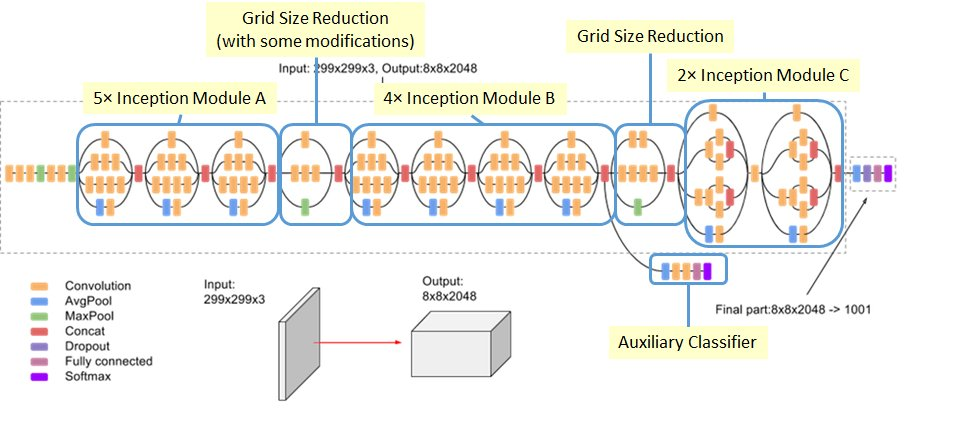

In [24]:
display_image("inceptionv3.jpg")

<p>
 Inception v3 TPU training runs match accuracy curves produced by GPU jobs of similar configuration. The model has been successfully trained on v2-8, v2-128, and v2-512 configurations. The model has attained greater than 78.1% accuracy in about 170 epochs on each of these.
    The model itself is made up of symmetric and asymmetric building blocks, including convolutions, average pooling, max pooling, concats, dropouts, and fully connected layers. Batchnorm is used extensively throughout the model and applied to activation inputs. Loss is computed via Softmax.
</p>
Inception basic block:


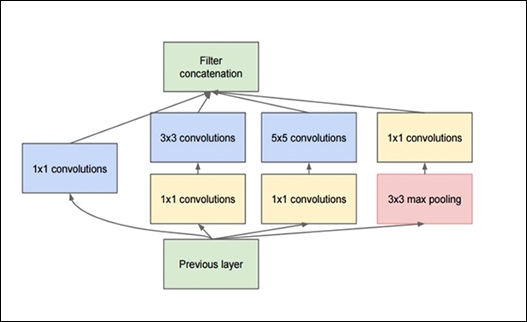

In [25]:
display_image("inceptionv3_block.jpg")

<p>
Comparison of Inception V3 against other known models:
    </p>



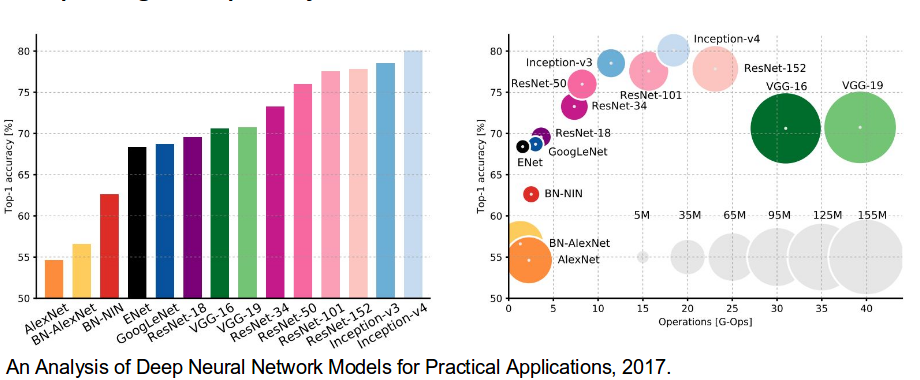

In [27]:
display_image("comparison.png")

<p>
We can see that InceptionV3 is in the upper spectrum when it comes to accuracy and efficiency.
</p>
You can learn more about InceptionV3 in the following article: <a href="https://static.googleusercontent.com/media/research.google.com/en//pubs/archive/44903.pdf">Inception V3 Paper</a>

In [135]:
from keras.applications.inception_v3 import InceptionV3

In [136]:
inception_v3 = InceptionV3(include_top=False, weights='imagenet', input_shape=(224,224,3))
inception_v3.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_130 (Conv2D)             (None, 111, 111, 32) 864         input_27[0][0]                   
__________________________________________________________________________________________________
batch_normalization_130 (BatchN (None, 111, 111, 32) 96          conv2d_130[0][0]                 
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization_130[0][0]    
_______________________________________________________________________________________

In [235]:
print(f'Inception V3 weights {len(inception_v3.weights)}')
print(f'Inception V3 trainable weights {len(inception_v3.trainable_weights)}')

print("Setting Inception V3 layers untrainable")
for layer in inception_v3.layers:
    layer.trainable = False

print(f'Inception V3 edited trainable weights {len(inception_v3.trainable_weights)}')

Inception V3 weights 376
Inception V3 trainable weights 188
Setting Inception V3 layers untrainable
Inception V3 edited trainable weights 0


<h3>3.a Add trainable output layers to the pre-trained model</h3>

In [137]:
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Input, MaxPool2D, Dropout, BatchNormalization, GlobalAveragePooling2D

x = GlobalAveragePooling2D()(inception_v3.output)
x = Dense(512, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
x = BatchNormalization()(x)
x = Dense(120, activation='softmax', name ='predictions')(x)

model = Model(inputs=inception_v3.input, outputs=x)
model.summary()

Model: "functional_53"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_130 (Conv2D)             (None, 111, 111, 32) 864         input_27[0][0]                   
__________________________________________________________________________________________________
batch_normalization_130 (BatchN (None, 111, 111, 32) 96          conv2d_130[0][0]                 
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization_130[0][0]    
______________________________________________________________________________________

In [253]:
print(f'Input shape: {model.layers[0].input_shape}')
print(f'Output shape: {model.layers[-1].output_shape}')

Input shape: [(None, 224, 224, 3)]
Output shape: (None, 120)


<h4>2.b. We will use strarisfied train-test split</h4>

In [308]:
from tensorflow.keras.preprocessing.image import load_img
from sklearn.preprocessing import OneHotEncoder
from sklearn.utils import shuffle
from tqdm import tqdm

def load_train_images():
    data, labels, filenames = [], [], []
    for idx, row in tqdm(labeled_data.iterrows()):
        sample = load_img(join(data_dir, 'train', row['id']), color_mode='rgb', target_size=(224,224))
        sample = np.array(sample)
        data.append(sample)
        labels.append(row['breed'])
        filenames.append(row['id'])
    X, y, filenames = np.array(data), np.array(labels), np.array(filenames)
    return shuffle(X, y, filenames, random_state=0)

X_train, y_train, filenames = load_train_images()

10222it [00:25, 393.25it/s]


In [309]:
from sklearn.model_selection import train_test_split

def create_startisfied_train_test_split(X, y, filenames):
    return train_test_split(np.array(list(zip(X, filenames))), y, test_size=0.2, random_state=0, stratify=y)
    
X_train_samples, X_valid_samples, y_train, y_valid = create_startisfied_train_test_split(X_train, y_train, filenames)
X_valid, valid_filenames = zip(*X_valid_samples)
X_train, train_filenames = zip(*X_train_samples)
X_valid = np.array([x for x in X_valid])
X_train = np.array([x for x in X_train])

C:\Users\Itay Bouganim\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  after removing the cwd from sys.path.


8177
8177


In [310]:
print(f'Validation labels stratisfied counts:')
unique, counts = np.unique(y_valid, return_counts=True)
print(list(zip(unique, counts))[:10])
y_valid_encoded = one_hot_encode(y_valid)

print(f'\n\nTrain labels stratisfied counts:')
unique, counts = np.unique(y_train, return_counts=True)
print(list(zip(unique, counts))[:10])
y_train_encoded = one_hot_encode(y_train)

Validation labels stratisfied counts:
[('affenpinscher', 16), ('afghan_hound', 23), ('african_hunting_dog', 17), ('airedale', 22), ('american_staffordshire_terrier', 15), ('appenzeller', 16), ('australian_terrier', 21), ('basenji', 22), ('basset', 16), ('beagle', 21)]


Train labels stratisfied counts:
[('affenpinscher', 64), ('afghan_hound', 93), ('african_hunting_dog', 69), ('airedale', 85), ('american_staffordshire_terrier', 59), ('appenzeller', 62), ('australian_terrier', 81), ('basenji', 88), ('basset', 66), ('beagle', 84)]


In [311]:
y_train = y_train_encoded
y_valid = y_valid_encoded

print('Training one-hot encoded outputs samples:')
print(y_train[np.random.choice(y_train.shape[0], 3, replace=False)])

print('\n\nValidation one-hot encoded outputs samples:')
print(y_valid[np.random.choice(y_valid.shape[0], 3, replace=False)])

Training one-hot encoded outputs samples:
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

In [312]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

aug_image_gen = ImageDataGenerator(rescale=1./255,
        shear_range=0.2,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        fill_mode='nearest',
        zoom_range=0.2,
        horizontal_flip=True)

valid_image_gen = ImageDataGenerator(rescale=1./255)

In [313]:
train_generator = aug_image_gen.flow(
    x=X_train,
    y=y_train,
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
)

valid_generator = valid_image_gen.flow(
    x=X_valid,
    y=y_valid,
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
)

<h3>3.c. Train our InceptionV3 transfer learning model</h3>

In [191]:
model.compile(loss='categorical_crossentropy',optimizer=Adam(learning_rate=0.001), metrics=['accuracy'])

In [274]:
inception_hist = model.fit(x=train_generator, validation_data=valid_generator, callbacks=get_callbacks(saved_model_name='inceptionv3'), epochs=20, verbose=2)

Epoch 1/20

Epoch 00001: val_accuracy improved from -inf to 0.74132, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_inceptionv3.h5
409/409 - 131s - loss: 2.1367 - accuracy: 0.4858 - val_loss: 0.8690 - val_accuracy: 0.7413
Epoch 2/20

Epoch 00002: val_accuracy improved from 0.74132 to 0.74377, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_inceptionv3.h5
409/409 - 127s - loss: 1.4722 - accuracy: 0.5940 - val_loss: 0.8556 - val_accuracy: 0.7438
Epoch 3/20

Epoch 00003: val_accuracy improved from 0.74377 to 0.75452, saving model to C:\My Files\School\Programming\Projects\Deep Learning\Assignments\Assignment1/data/dog-breed/saved_models\model_inceptionv3.h5
409/409 - 127s - loss: 1.3904 - accuracy: 0.6213 - val_loss: 0.8131 - val_accuracy: 0.7545
Epoch 4/20

Epoch 00004: val_accuracy improved from 0.75452 to 0.76675, saving model 

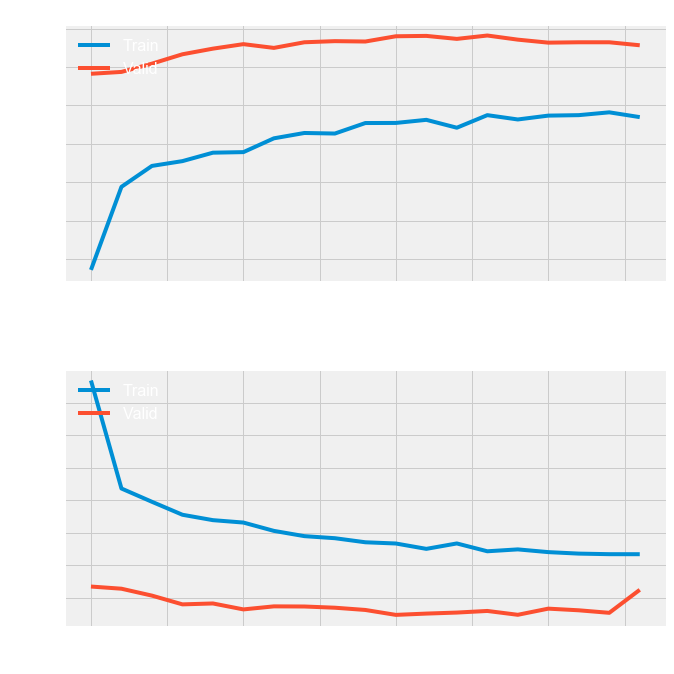

In [301]:
plot_model_stats(inception_hist)

In [305]:
def print_model_stats(h):
    print(f"Last epoch accuracy: {round(statistics.mean(h.history['accuracy'][-1:]) * 100, 2)}%")
    print(f"Last epoch loss: {statistics.mean(h.history['loss'][-1:])}")
    print(f"Last epoch validation accuracy: {round(statistics.mean(h.history['val_accuracy'][-1:]) * 100, 2)}%")
    print(f"Last epoch validation loss: {statistics.mean(h.history['val_loss'][-1:])}")

In [310]:
print_model_stats(inception_hist)

Last epoch accuracy: 68.48%
Last epoch loss: 1.0679259300231934
Last epoch validation accuracy: 77.85%
Last epoch validation loss: 0.8487804532051086


In [242]:
def calculate_confusion_matrix_train_test(saved_model_prefix, dims, model):
    model.load_weights(join(model_save_dir, f"model_{saved_model_prefix}.h5"))
    y_pred = model.predict(X_valid / 255.)
    y_pred_classes = np.argmax(y_pred,axis = 1) 
    y_true = np.argmax(y_valid, axis=1)
    
    y_pred_labeled = [{'pred_label': index_to_label[pred], 'true_label': index_to_label[y_true[i]],
                      'filename': valid_filenames[i], 'perc': np.amax(y_pred[i])} for i, pred in enumerate(y_pred_classes)]
    correct_pred = list(filter(lambda pred: pred['pred_label'] == pred['true_label'], y_pred_labeled))
    worst_wrong_pred = sorted(list(filter(lambda pred: pred['pred_label'] != pred['true_label'], y_pred_labeled)), key=lambda e: e['perc'], reverse=True)[:10]
    correct_perc = len(correct_pred) / len(valid_filenames)
    return {'confusion':confusion_matrix(y_true, y_pred_classes), 'correct': sorted(correct_pred, key=lambda e: e['perc'], reverse=True)[:10],
            'wrong': worst_wrong_pred, 'correct_perc': correct_perc}

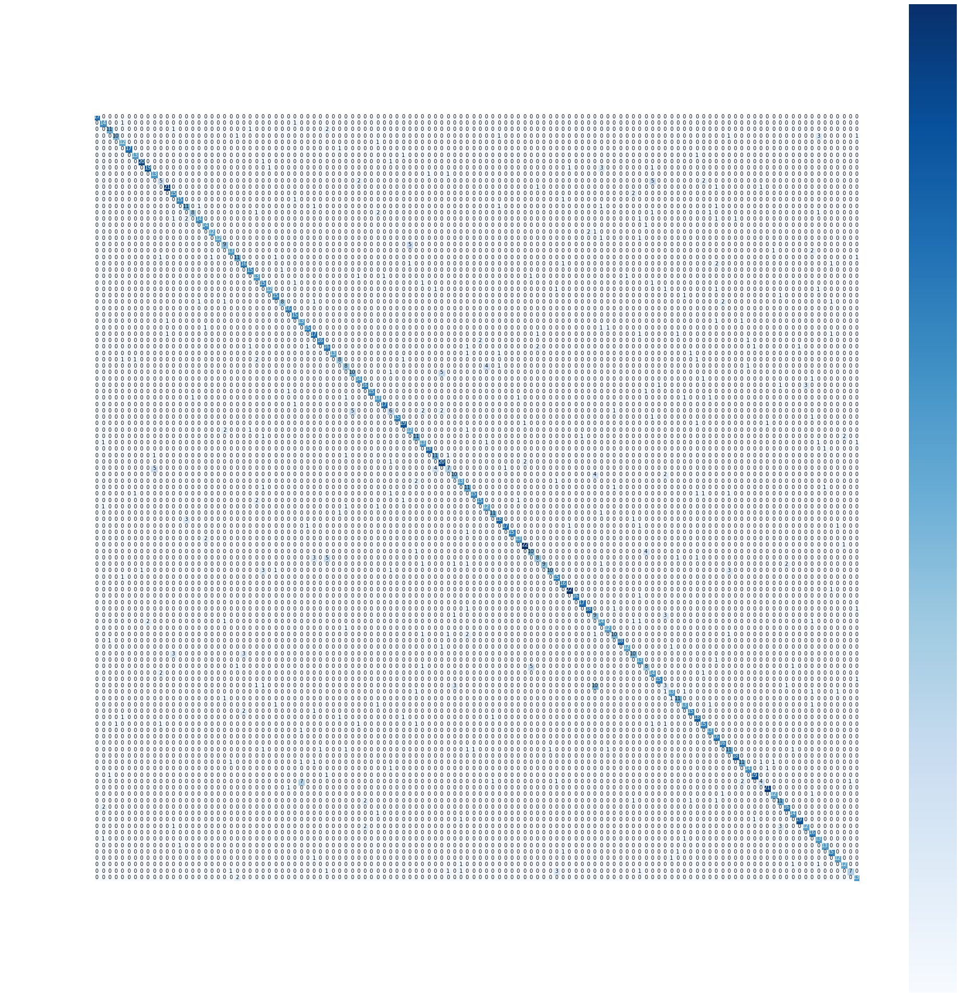

In [247]:
inceptionv3_cnn_metrics = calculate_confusion_matrix_train_test(saved_model_prefix='inceptionv3', dims=224, model=model)
plot_confusion_matrix(inceptionv3_cnn_metrics['confusion'], labels=labels, title="Confusion Matrix InceptionV3 based CNN")

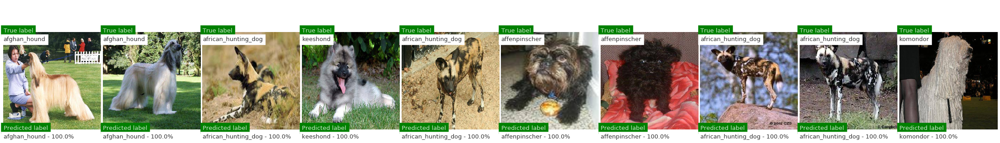

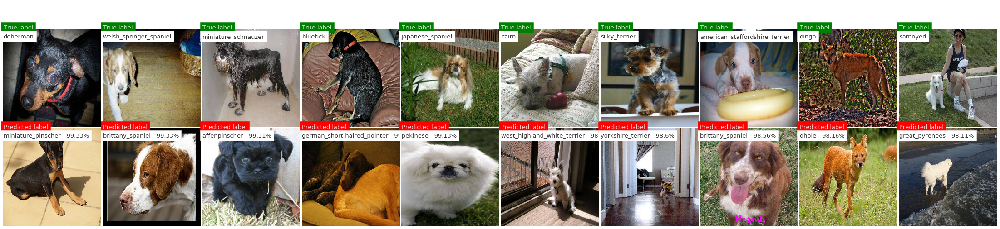

In [248]:
read_and_plot_correct_wrong(correct=inceptionv3_cnn_metrics['correct'], wrong=inceptionv3_cnn_metrics['wrong'])

We can see by the predictions samples that we got big imporvement by using InceptionV3.<br/>
Most of the wrong predictions that we got are hard to seperate just by looking at the pictures.<br/> The wrong predictions dog breeds are very simillar looking in terms of shape, hair, color and size.<br/>
We can also see that the correct and wrong predictions are very high for the top samples, this can indicate that our model is very decisive this time around.

In [250]:
print('Correct percentage: {}%'.format(round(inceptionv3_cnn_metrics['correct_perc'] * 100, 2)))

Correct percentage: 79.12%


<h4>We can clearly see from the matrix above that using InceptionV3 as the base model is a big improvement to our custom CNN</h4>

In [346]:
def create_submission_file_inceptionv3(X_test, test_ids, name, dims, saved_model_prefix, model):
    model.load_weights(join(model_save_dir, f"{saved_model_prefix}.h5"))
    predictions = model.predict(X_test, batch_size=BATCH_SIZE, verbose=2)
    submission_res = pd.DataFrame(data=predictions, index=test_ids, columns=np.array([*label_to_index]))
    submission_res = submission_res.sort_index(axis=1)
    submission_res.index.name = 'id'
    submission_res.to_csv(join(data_dir, name), encoding='utf-8', index=True)
    submission_data = pd.read_csv(join(data_dir, name))
    return submission_data

In [320]:
X_test, test_ids = get_test_samples(preprocess_func=lambda s: s / 225., dims=224, dtype=np.float64)

Loading test data



  0%|                                                                                                                                                             | 4/10357 [00:00<05:22, 32.09it/s]

(10357, 224, 224, 3)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10357/10357 [01:54<00:00, 90.84it/s]


In [347]:
submission_data = create_submission_file_inceptionv3(X_test=X_test, test_ids=test_ids, name='inceptionv3_submission.csv', dims=224,
                                         saved_model_prefix='model_inceptionv3', model=model)
submission_data

518/518 - 92s


,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,0.000122,1.997432e-04,1.512205e-06,1.535732e-07,1.690818e-08,1.354579e-07,2.576929e-06,8.333871e-08,8.343577e-07,...,1.402244e-06,3.958630e-07,1.688202e-06,2.035644e-07,7.043890e-07,7.745700e-07,4.252997e-07,4.304712e-08,5.056384e-06,1.437696e-05
1,00102ee9d8eb90812350685311fe5890,0.000001,1.953093e-09,7.254951e-08,2.198116e-07,5.376096e-06,8.215196e-07,8.389158e-08,3.947013e-07,4.224020e-07,...,6.629390e-07,2.064723e-06,2.083986e-07,1.468025e-05,1.892292e-05,3.720663e-07,2.547189e-04,2.666109e-07,1.154604e-06,3.045920e-07
2,0012a730dfa437f5f3613fb75efcd4ce,0.000004,1.249285e-01,4.775828e-04,4.788253e-05,3.150315e-05,6.404155e-06,1.602149e-04,4.267707e-06,7.186257e-05,...,2.025650e-06,5.285336e-06,3.752922e-04,2.144447e-04,1.443993e-03,1.460943e-04,2.915576e-06,2.335792e-02,3.213605e-05,5.789116e-04
3,001510bc8570bbeee98c8d80c8a95ec1,0.003182,2.659749e-03,8.035110e-04,2.513948e-03,1.551429e-04,1.451453e-01,1.311704e-04,2.154395e-01,9.541432e-03,...,1.987892e-03,4.620255e-03,1.001725e-03,5.018954e-03,3.078051e-04,3.698469e-05,6.307058e-03,1.706925e-02,7.465795e-04,1.395639e-03
4,001a5f3114548acdefa3d4da05474c2e,0.038793,5.680982e-05,7.030024e-05,5.066290e-07,8.997701e-06,4.543847e-06,4.656462e-04,9.807300e-06,2.087053e-05,...,3.378397e-05,2.376743e-05,1.499276e-05,3.978268e-05,1.857818e-05,2.180684e-05,4.077354e-04,2.065280e-06,2.855959e-05,8.409017e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10352,ffeda8623d4eee33c6d1156a2ecbfcf8,0.000031,2.386003e-03,5.829728e-06,2.402039e-05,2.045461e-04,5.810452e-06,2.231237e-05,2.824520e-06,3.555507e-05,...,1.452536e-02,3.335844e-06,2.136583e-05,4.973574e-06,1.901992e-04,2.048868e-06,7.087192e-05,7.844208e-05,9.225511e-05,7.228808e-05
10353,fff1ec9e6e413275984966f745a313b0,0.000006,5.177933e-05,2.534736e-05,9.219802e-06,2.342470e-03,5.331960e-05,1.312880e-06,6.529973e-06,3.310814e-03,...,3.504906e-06,2.401402e-06,2.800407e-05,2.561131e-04,5.582420e-01,1.237938e-05,7.196153e-05,6.173470e-03,2.687479e-06,1.332929e-05
10354,fff74b59b758bbbf13a5793182a9bbe4,0.002696,1.533445e-04,2.977253e-02,2.218070e-06,9.650048e-06,3.064542e-05,3.514635e-03,1.043879e-04,1.264548e-04,...,3.265220e-05,1.563324e-03,1.670576e-04,3.491375e-04,4.664837e-05,1.655976e-04,3.729510e-05,4.796241e-05,8.349876e-06,3.941266e-03
10355,fff7d50d848e8014ac1e9172dc6762a3,0.000405,2.674073e-06,1.323689e-06,1.253531e-07,1.099248e-06,3.779833e-06,2.618770e-05,4.746941e-06,2.005733e-05,...,2.473992e-05,6.755071e-07,5.214762e-06,1.360822e-06,2.376353e-07,8.088533e-07,7.062133e-05,6.302553e-07,9.513592e-07,2.396691e-05


<h3>Kaggle multiclass loss score: 1.85799</h3>
<h4>Lower is better</h4>

<h2>3.d. Use our Transfer Learning InceptionV3 based model as feature extractor for SVM</h2>
<h4> Using Linear Support Vector Machine algorithm </h4>
We are going to use the model trained in the previous section to extract our dataset features and apply the Linear support vector machines (SVM) ML algorithm to classify our data using those features

<h3> About Support Vector Machine (SVM)</h3>
<p>
 Support-vector machines (SVMs, also support-vector networks) are supervised learning models with associated learning algorithms that analyze data used for classification and regression analysis.<br/>
 More formally, a support-vector machine constructs a hyperplane or set of hyperplanes in a high- or infinite-dimensional space, which can be used for classification, regression, or other tasks like outliers detection.<br/>
 A good separation is achieved by the hyperplane that has the largest distance to the nearest training-data point of any class (so-called functional margin), since in general the larger the margin, the lower the generalization error of the classifier.
</p>


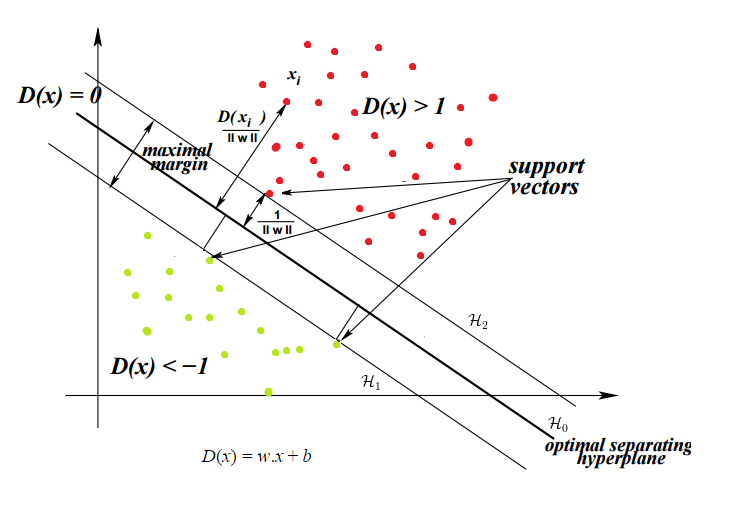


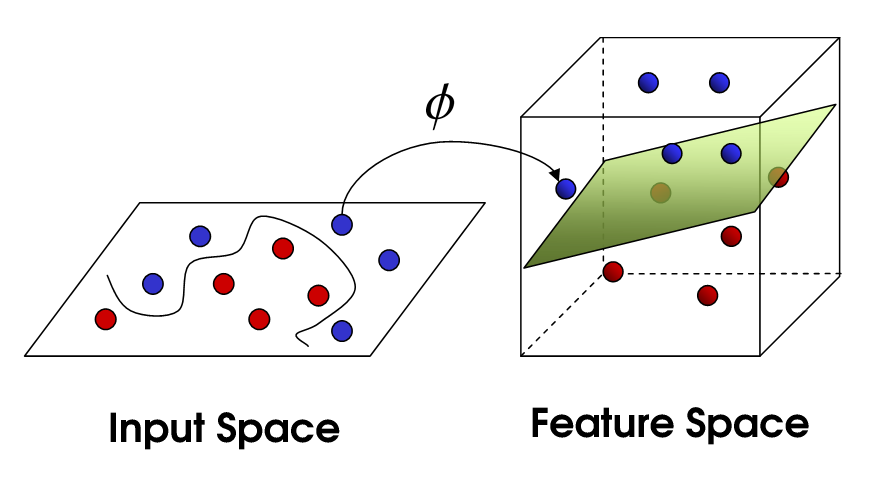

In [8]:
display_image("svm.png")
display_image("svm2.png")

In [314]:
# Load custom InceptionV3 model weights
inceptionv3_model = model
inceptionv3_model.load_weights(join(model_save_dir, f"model_inceptionv3.h5"))

In [315]:
from keras import backend as K

for layer_idx in range(len(inceptionv3_model.layers)):
    print(layer_idx, inceptionv3_model.layers[layer_idx])

0 <tensorflow.python.keras.engine.input_layer.InputLayer object at 0x00000229633DEE88>
1 <tensorflow.python.keras.layers.convolutional.Conv2D object at 0x00000229633DE508>
2 <tensorflow.python.keras.layers.normalization_v2.BatchNormalization object at 0x0000022958CCC308>
3 <tensorflow.python.keras.layers.core.Activation object at 0x0000022958CCC3C8>
4 <tensorflow.python.keras.layers.convolutional.Conv2D object at 0x000002295F1B2648>
5 <tensorflow.python.keras.layers.normalization_v2.BatchNormalization object at 0x000002296371C748>
6 <tensorflow.python.keras.layers.core.Activation object at 0x0000022966EDE948>
7 <tensorflow.python.keras.layers.convolutional.Conv2D object at 0x0000022966EDE288>
8 <tensorflow.python.keras.layers.normalization_v2.BatchNormalization object at 0x000002295DECD3C8>
9 <tensorflow.python.keras.layers.core.Activation object at 0x0000022966DE6108>
10 <tensorflow.python.keras.layers.pooling.MaxPooling2D object at 0x0000022966DE6C48>
11 <tensorflow.python.keras.laye

In [316]:
print("Setting Custom Inception V3 layers untrainable")
for layer in inceptionv3_model.layers:
    layer.trainable = False

inceptionv3_model.summary()

Setting Custom Inception V3 layers untrainable
Model: "functional_53"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_130 (Conv2D)             (None, 111, 111, 32) 864         input_27[0][0]                   
__________________________________________________________________________________________________
batch_normalization_130 (BatchN (None, 111, 111, 32) 96          conv2d_130[0][0]                 
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization_130[0][0]    
_______________________________________

In [317]:
svm_inceptionv3_model = Model(inputs=inceptionv3_model.inputs, outputs=inceptionv3_model.layers[-2].output)
svm_inceptionv3_model.summary()

Model: "functional_61"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_27 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_130 (Conv2D)             (None, 111, 111, 32) 864         input_27[0][0]                   
__________________________________________________________________________________________________
batch_normalization_130 (BatchN (None, 111, 111, 32) 96          conv2d_130[0][0]                 
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization_130[0][0]    
______________________________________________________________________________________

In [371]:
def extract_features(model, X):
    return model.predict(X)

In [369]:
def hot_encode_to_index(Y):
    return np.argmax(Y, axis=1)

In [370]:
train_features = extract_features(svm_inceptionv3_model, X_train)
valid_features = extract_features(svm_inceptionv3_model, X_valid)

svm_features = np.concatenate((train_features, valid_features))
svm_labels = np.concatenate((hot_encode_to_index(y_train), hot_encode_to_index(y_valid)))

print(svm_labels)

[105   5  90 ...  99  34  26]


<h3>We will use RBF(Radial basis function kernel) boundary decision </h3>


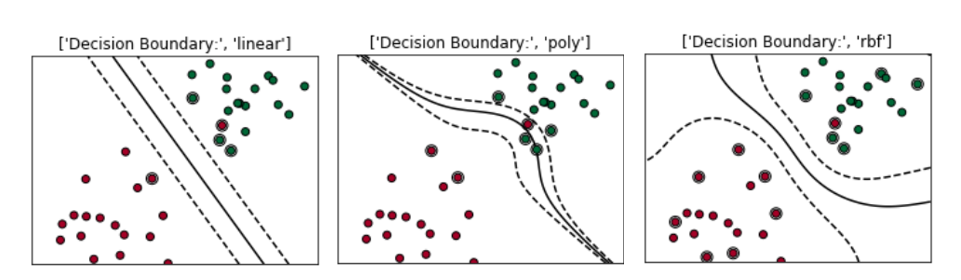

In [9]:
display_image("rbf.png")

In [384]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC

parameters = {
                'kernel':['rbf'], # Radial basis function kernel
                'gamma': [1e-3, 1e-4], # Intuitively, the gamma parameter defines how far the influence of a single training example reaches, with low values meaning ‘far’ and high values meaning ‘close’. 
                'C':[1, 10, 100, 1000]
             }
'''Grid search is the process of performing hyper parameter tuning in order to determine the optimal values for a given model.
A cross validation process is performed in order to determine the hyper parameter value set which provides the best accuracy levels.'''
clf = GridSearchCV(estimator=SVC(), param_grid=parameters, verbose=10)
clf = clf.fit(svm_features / 255., svm_labels)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
[CV] C=1, gamma=0.001, kernel=rbf ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] ........ C=1, gamma=0.001, kernel=rbf, score=0.013, total=  55.9s
[CV] C=1, gamma=0.001, kernel=rbf ....................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   55.8s remaining:    0.0s


[CV] ........ C=1, gamma=0.001, kernel=rbf, score=0.012, total=  57.6s
[CV] C=1, gamma=0.001, kernel=rbf ....................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:  1.9min remaining:    0.0s


[CV] ........ C=1, gamma=0.001, kernel=rbf, score=0.012, total=  55.8s
[CV] C=1, gamma=0.001, kernel=rbf ....................................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:  2.8min remaining:    0.0s


[CV] ........ C=1, gamma=0.001, kernel=rbf, score=0.012, total=  55.6s
[CV] C=1, gamma=0.001, kernel=rbf ....................................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  3.7min remaining:    0.0s


[CV] ........ C=1, gamma=0.001, kernel=rbf, score=0.012, total=  57.1s
[CV] C=1, gamma=0.0001, kernel=rbf ...................................


[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  4.7min remaining:    0.0s


[CV] ....... C=1, gamma=0.0001, kernel=rbf, score=0.013, total=  55.0s
[CV] C=1, gamma=0.0001, kernel=rbf ...................................


[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:  5.6min remaining:    0.0s


[CV] ....... C=1, gamma=0.0001, kernel=rbf, score=0.012, total=  57.0s
[CV] C=1, gamma=0.0001, kernel=rbf ...................................


[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:  6.6min remaining:    0.0s


[CV] ....... C=1, gamma=0.0001, kernel=rbf, score=0.012, total=  54.8s
[CV] C=1, gamma=0.0001, kernel=rbf ...................................


[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  7.5min remaining:    0.0s


[CV] ....... C=1, gamma=0.0001, kernel=rbf, score=0.012, total=  57.6s
[CV] C=1, gamma=0.0001, kernel=rbf ...................................


[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:  8.4min remaining:    0.0s


[CV] ....... C=1, gamma=0.0001, kernel=rbf, score=0.012, total=  54.8s
[CV] C=10, gamma=0.001, kernel=rbf ...................................
[CV] ....... C=10, gamma=0.001, kernel=rbf, score=0.013, total=  58.8s
[CV] C=10, gamma=0.001, kernel=rbf ...................................
[CV] ....... C=10, gamma=0.001, kernel=rbf, score=0.012, total=  56.3s
[CV] C=10, gamma=0.001, kernel=rbf ...................................
[CV] ....... C=10, gamma=0.001, kernel=rbf, score=0.012, total=  58.4s
[CV] C=10, gamma=0.001, kernel=rbf ...................................
[CV] ....... C=10, gamma=0.001, kernel=rbf, score=0.012, total=  56.6s
[CV] C=10, gamma=0.001, kernel=rbf ...................................
[CV] ....... C=10, gamma=0.001, kernel=rbf, score=0.012, total=  58.3s
[CV] C=10, gamma=0.0001, kernel=rbf ..................................
[CV] ...... C=10, gamma=0.0001, kernel=rbf, score=0.013, total=  55.3s
[CV] C=10, gamma=0.0001, kernel=rbf ..................................
[CV] .

[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed: 38.1min finished


In [391]:
import pickle

# save
with open(join(data_dir, 'saved_models', 'svm_model.pkl'),'wb') as file:
    pickle.dump(clf, file)

In [410]:
def calculate_confusion_matrix_svm_train_test():
    with open(join(data_dir, 'saved_models', 'svm_model.pkl'),'rb') as file:
        clf2 = pickle.load(file)
        y_pred = clf2.predict(valid_features / 255.)
        y_true = hot_encode_to_index(y_valid)
        
        y_pred_labeled = [{'pred_label': index_to_label[pred], 'true_label': index_to_label[y_true[i]],
                      'filename': valid_filenames[i], 'perc': np.amax(y_pred[i])} for i, pred in enumerate(y_pred)]
        correct_pred = list(filter(lambda pred: pred['pred_label'] == pred['true_label'], y_pred_labeled))
        worst_wrong_pred = sorted(list(filter(lambda pred: pred['pred_label'] != pred['true_label'], y_pred_labeled)), key=lambda e: e['perc'], reverse=True)[:10]
        correct_perc = len(correct_pred) / len(valid_filenames)
        return {'confusion': confusion_matrix(y_true, y_pred), 'correct': sorted(correct_pred, key=lambda e: e['perc'], reverse=True)[:10],
                'wrong': worst_wrong_pred, 'correct_perc': correct_perc}

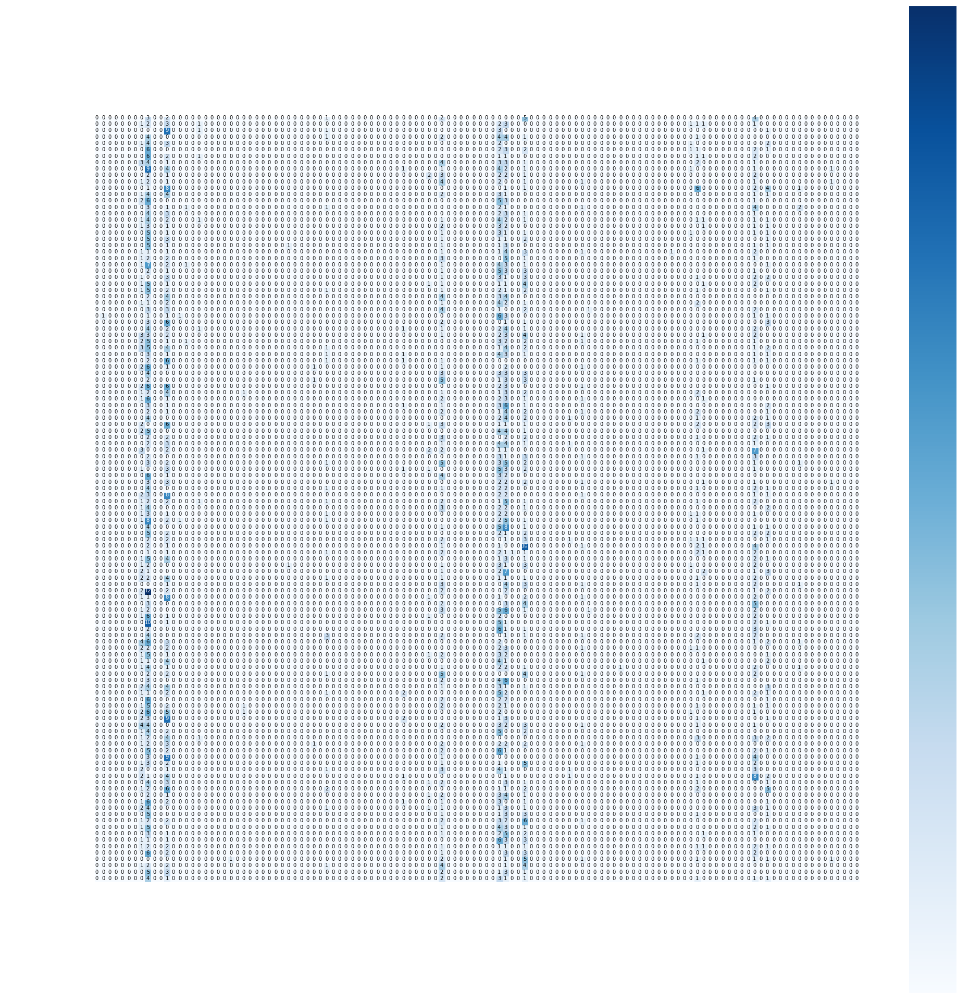

In [411]:
svm_cnn_metrics = calculate_confusion_matrix_svm_train_test()
plot_confusion_matrix(svm_cnn_metrics['confusion'], labels=labels, title="Confusion Matrix InceptionV3 based CNN Feature Extractor with SVM Classifier") # Tune hyperparameters SVM fit

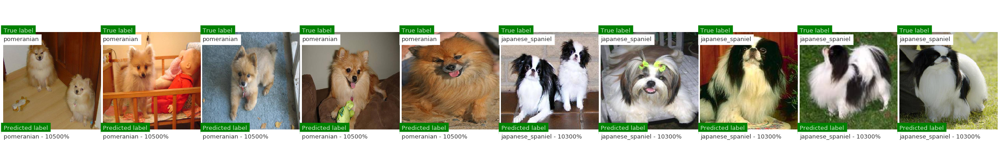

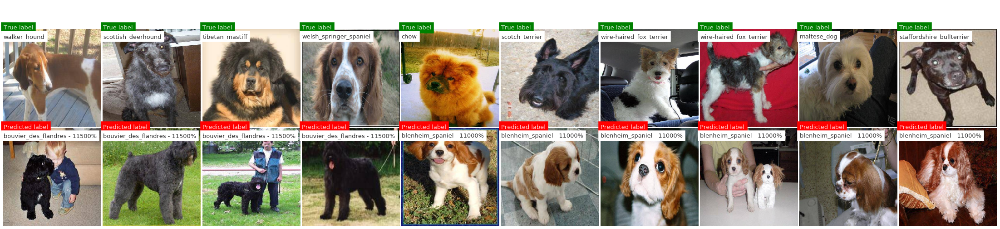

In [412]:
read_and_plot_correct_wrong(correct=svm_cnn_metrics['correct'], wrong=svm_cnn_metrics['wrong'])

In [414]:
print('Correct percentage: {}%'.format(round(svm_cnn_metrics['correct_perc'] * 100, 2)))

Correct percentage: 3.23%


<h2>3.e. Results Summary and Model comparison</h2>


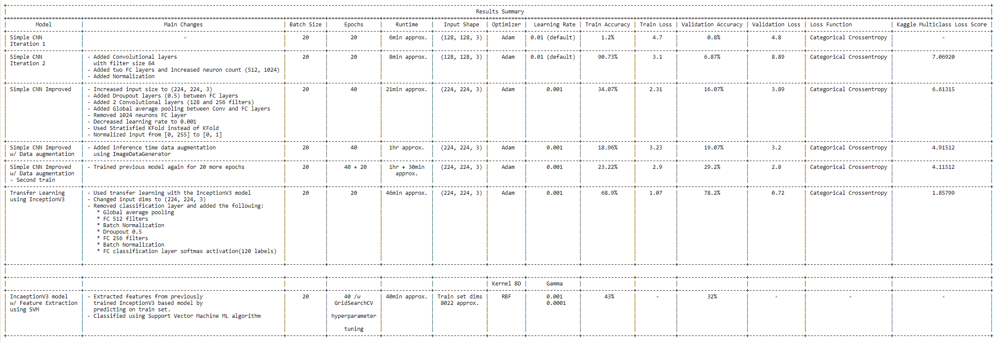

In [13]:
display_image("results.png")

<h2>4. Summary Report</h2>

In this section we will present a detailed report re